In [187]:
from IPython.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [188]:
import tensorflow as tf
import numpy as np
 
from train_model import train_model
from data_processing import segment_spectrum, segment_spectrum_batch
from RamanNet_model import RamanNet

import shap
from tensorflow.compat.v1.keras.backend import get_session
import tensorflow.compat.v1.keras.backend as K 


#tf.compat.v1.disable_eager_execution()
#tf.compat.v1.disable_v2_behavior()

In [395]:
# prepare data
compound = 0
data_path = '/home/jeonggyu/workspace/data' 
#X_datafile = data_path+'/DeepCID/augmented_data/covid_backup/raw/'+str(compound)+'component.npy' 
#y_datafile = data_path+'/DeepCID/augmented_data/covid_backup/raw/'+str(compound)+'label.npy' 
#X_datafile = data_path+'/DeepCID/augmented_data/covid/'+str(compound)+'component.npy' 
#y_datafile = data_path+'/DeepCID/augmented_data/covid/'+str(compound)+'label.npy' 
#X_datafile = data_path+'/DeepCID/augmented_data/ramcell/'+str(compound)+'component.npy' 
#y_datafile = data_path+'/DeepCID/augmented_data/ramcell/'+str(compound)+'label.npy' 
#X_datafile = data_path+'/DeepCID/augmented_data/ramcell_backup/1019/ecoli_sa/'+str(compound)+'component.npy' 
#y_datafile = data_path+'/DeepCID/augmented_data/ramcell_backup/1019/ecoli_sa/'+str(compound)+'label.npy' 
X_datafile = data_path+'/DeepCID/augmented_data/ramcell_backup/1019/ecoli_sa_mix6_mix8/'+str(compound)+'component.npy' 
y_datafile = data_path+'/DeepCID/augmented_data/ramcell_backup/1019/ecoli_sa_mix6_mix8/'+str(compound)+'label.npy' 
wavenum_datafile = data_path+'/ramcell/wavenum.npy' 
#wavenum_datafile = data_path+'/CoV/processed/wavenum.npy' 

#labels=['Pos','Neg','Blank']
#labels=['e. coli', 's. aureus', 'noise', 'mix (10^8)']
labels=['e. coli', 's. aureus', 'mix (10^6)', 'mix (10^8)']

X = np.load(X_datafile)
y = np.load(y_datafile)
wavenum = np.load(wavenum_datafile)

############ wavenum [:1604] ################
#X=X[:,65:]
#wavenum=wavenum[65:]

y = y.reshape(y.shape[0]).astype(np.int)
num = np.unique(y, axis=0)
num = num.shape[0]
y_ = np.eye(num)[y]

r = int(y_.shape[0]*0.1+0.5)

X_train = X[0:r*6]
X_val = X[r*6:r*8]
X_test = X[r*8:]
y_train = y_[0:r*6]
y_val = y_[r*6:r*8]
y_test = y_[r*8:]

print(X.shape, y_.shape, wavenum.shape)
print(wavenum)

print(X_train.shape,X_val.shape,X_test.shape,y_train.shape,y_val.shape,y_test.shape)


(2544, 1015) (2544, 4) (1015,)
[1669.533203 1668.545898 1667.557617 ...  551.817383  550.578125
  549.337891]
(1524, 1015) (508, 1015) (512, 1015) (1524, 4) (508, 4) (512, 4)


`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations


In [403]:
X_cls=[]
for c in range(num):
    X_cls.append([])
print(np.array(X_cls).shape)

for i in range(X.shape[0]):
    for c in range(num):
        if y[i]==c:
            X_cls[c].append(X[i])

for c in range(num):
    print(len(X_cls[c]))


(4, 0)
636
636
636
636


In [413]:
np.average(X_cls[0],axis=0)

array([0.07200726, 0.11760932, 0.14734721, ..., 0.13939359, 0.13794133,
       0.13776349])

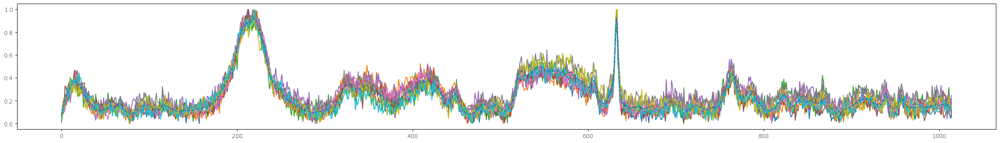

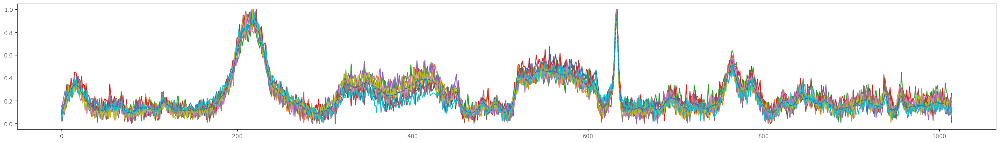

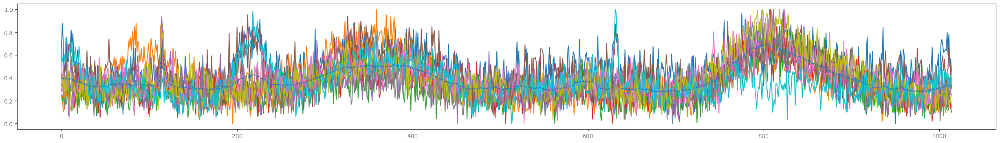

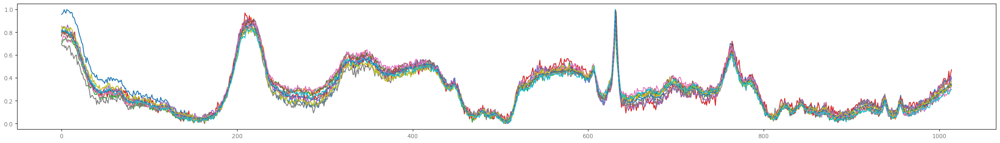

In [414]:
for c in range(num):
    for i in range(10):
        plt.plot(X_cls[c][i])
    plt.plot(np.average(X_cls[c],axis=0),'--')
    plt.show()

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:1',)
X shape :  (39, 1524, 50) (39, 508, 50) 50 1524
Y shape :  (1524,) (1524, 4) (508,) (508,)
50 1524 4
(None, 256)
Epoch 1/500


2022-12-13 11:14:01.652533: W tensorflow/core/grappler/optimizers/data/auto_shard.cc:776] AUTO sharding policy will apply DATA sharding policy as it failed to apply FILE sharding policy because of the following reason: Did not find a shardable source, walked to a node which is not a dataset: name: "FlatMapDataset/_9"
op: "FlatMapDataset"
input: "PrefetchDataset/_8"
attr {
  key: "Targuments"
  value {
    list {
    }
  }
}
attr {
  key: "_cardinality"
  value {
    i: -2
  }
}
attr {
  key: "f"
  value {
    func {
      name: "__inference_Dataset_flat_map_slice_batch_indices_1983439"
    }
  }
}
attr {
  key: "metadata"
  value {
    s: "\n\023FlatMapDataset:3541"
  }
}
attr {
  key: "output_shapes"
  value {
    list {
      shape {
        dim {
          size: -1
        }
      }
    }
  }
}
attr {
  key: "output_types"
  value {
    list {
      type: DT_INT64
    }
  }
}
experimental_type {
  type_id: TFT_PRODUCT
  args {
    type_id: TFT_DATASET
    args {
      type_id: TFT_P

4/4 [==============================] - ETA: 0s - loss: 1.0039 - embedding_loss: 0.9864 - classification_loss: 1.0214

2022-12-13 11:14:12.654771: W tensorflow/core/grappler/optimizers/data/auto_shard.cc:776] AUTO sharding policy will apply DATA sharding policy as it failed to apply FILE sharding policy because of the following reason: Did not find a shardable source, walked to a node which is not a dataset: name: "FlatMapDataset/_9"
op: "FlatMapDataset"
input: "PrefetchDataset/_8"
attr {
  key: "Targuments"
  value {
    list {
    }
  }
}
attr {
  key: "_cardinality"
  value {
    i: -2
  }
}
attr {
  key: "f"
  value {
    func {
      name: "__inference_Dataset_flat_map_slice_batch_indices_2001885"
    }
  }
}
attr {
  key: "metadata"
  value {
    s: "\n\023FlatMapDataset:3586"
  }
}
attr {
  key: "output_shapes"
  value {
    list {
      shape {
        dim {
          size: -1
        }
      }
    }
  }
}
attr {
  key: "output_types"
  value {
    list {
      type: DT_INT64
    }
  }
}
experimental_type {
  type_id: TFT_PRODUCT
  args {
    type_id: TFT_DATASET
    args {
      type_id: TFT_P


Epoch 1: val_loss improved from inf to 1.20670, saving model to /home/jeonggyu/workspace/data/RamanNet
INFO:tensorflow:Assets written to: /home/jeonggyu/workspace/data/RamanNet/assets
4/4 [==============================] - 26s 5s/step - loss: 1.0039 - embedding_loss: 0.9864 - classification_loss: 1.0214 - val_loss: 1.2067 - val_embedding_loss: 0.9015 - val_classification_loss: 1.5119 - lr: 0.0010
Epoch 2/500
4/4 [==============================] - ETA: 0s - loss: 0.5967 - embedding_loss: 0.8897 - classification_loss: 0.3036
Epoch 2: val_loss did not improve from 1.20670
4/4 [==============================] - 1s 151ms/step - loss: 0.5967 - embedding_loss: 0.8897 - classification_loss: 0.3036 - val_loss: 1.3703 - val_embedding_loss: 0.8980 - val_classification_loss: 1.8426 - lr: 0.0010
Epoch 3/500
4/4 [==============================] - ETA: 0s - loss: 0.5133 - embedding_loss: 0.8040 - classification_loss: 0.2226
Epoch 3: val_loss did not improve from 1.20670
4/4 [========================

Epoch 18/500
4/4 [==============================] - ETA: 0s - loss: 0.1592 - embedding_loss: 0.3023 - classification_loss: 0.0160
Epoch 18: val_loss did not improve from 0.40076
4/4 [==============================] - 1s 157ms/step - loss: 0.1592 - embedding_loss: 0.3023 - classification_loss: 0.0160 - val_loss: 0.5032 - val_embedding_loss: 0.5248 - val_classification_loss: 0.4815 - lr: 0.0010
Epoch 19/500
4/4 [==============================] - ETA: 0s - loss: 0.1459 - embedding_loss: 0.2799 - classification_loss: 0.0118
Epoch 19: val_loss did not improve from 0.40076
4/4 [==============================] - 1s 157ms/step - loss: 0.1459 - embedding_loss: 0.2799 - classification_loss: 0.0118 - val_loss: 0.5091 - val_embedding_loss: 0.5319 - val_classification_loss: 0.4864 - lr: 0.0010
Epoch 20/500
4/4 [==============================] - ETA: 0s - loss: 0.1600 - embedding_loss: 0.3004 - classification_loss: 0.0196
Epoch 20: val_loss did not improve from 0.40076
4/4 [=========================

4/4 [==============================] - ETA: 0s - loss: 0.0740 - embedding_loss: 0.1385 - classification_loss: 0.0095
Epoch 38: val_loss did not improve from 0.40076
4/4 [==============================] - 1s 160ms/step - loss: 0.0740 - embedding_loss: 0.1385 - classification_loss: 0.0095 - val_loss: 0.4905 - val_embedding_loss: 0.4303 - val_classification_loss: 0.5507 - lr: 8.1000e-04
Epoch 39/500
4/4 [==============================] - ETA: 0s - loss: 0.0402 - embedding_loss: 0.0727 - classification_loss: 0.0077
Epoch 39: val_loss did not improve from 0.40076
4/4 [==============================] - 1s 163ms/step - loss: 0.0402 - embedding_loss: 0.0727 - classification_loss: 0.0077 - val_loss: 0.5705 - val_embedding_loss: 0.4473 - val_classification_loss: 0.6937 - lr: 8.1000e-04
Epoch 40/500
4/4 [==============================] - ETA: 0s - loss: 0.0307 - embedding_loss: 0.0539 - classification_loss: 0.0074
Epoch 40: val_loss did not improve from 0.40076
4/4 [==============================

Epoch 58/500
4/4 [==============================] - ETA: 0s - loss: 0.0362 - embedding_loss: 0.0634 - classification_loss: 0.0090
Epoch 58: val_loss did not improve from 0.36750
4/4 [==============================] - 1s 154ms/step - loss: 0.0362 - embedding_loss: 0.0634 - classification_loss: 0.0090 - val_loss: 0.4031 - val_embedding_loss: 0.3456 - val_classification_loss: 0.4606 - lr: 7.2900e-04
Epoch 59/500
4/4 [==============================] - ETA: 0s - loss: 0.0236 - embedding_loss: 0.0393 - classification_loss: 0.0079
Epoch 59: val_loss did not improve from 0.36750
4/4 [==============================] - 1s 155ms/step - loss: 0.0236 - embedding_loss: 0.0393 - classification_loss: 0.0079 - val_loss: 0.4111 - val_embedding_loss: 0.3514 - val_classification_loss: 0.4707 - lr: 7.2900e-04
Epoch 60/500
4/4 [==============================] - ETA: 0s - loss: 0.0223 - embedding_loss: 0.0388 - classification_loss: 0.0059
Epoch 60: val_loss did not improve from 0.36750
4/4 [=================

INFO:tensorflow:Assets written to: /home/jeonggyu/workspace/data/RamanNet/assets
4/4 [==============================] - 13s 4s/step - loss: 0.0144 - embedding_loss: 0.0222 - classification_loss: 0.0066 - val_loss: 0.1748 - val_embedding_loss: 0.2295 - val_classification_loss: 0.1201 - lr: 6.5610e-04
Epoch 76/500
4/4 [==============================] - ETA: 0s - loss: 0.0132 - embedding_loss: 0.0237 - classification_loss: 0.0028
Epoch 76: val_loss improved from 0.17482 to 0.14306, saving model to /home/jeonggyu/workspace/data/RamanNet
INFO:tensorflow:Assets written to: /home/jeonggyu/workspace/data/RamanNet/assets
4/4 [==============================] - 14s 4s/step - loss: 0.0132 - embedding_loss: 0.0237 - classification_loss: 0.0028 - val_loss: 0.1431 - val_embedding_loss: 0.2004 - val_classification_loss: 0.0857 - lr: 6.5610e-04
Epoch 77/500
4/4 [==============================] - ETA: 0s - loss: 0.0173 - embedding_loss: 0.0297 - classification_loss: 0.0049
Epoch 77: val_loss improved fr

4/4 [==============================] - ETA: 0s - loss: 0.0139 - embedding_loss: 0.0197 - classification_loss: 0.0080
Epoch 93: val_loss improved from 0.10212 to 0.10017, saving model to /home/jeonggyu/workspace/data/RamanNet
INFO:tensorflow:Assets written to: /home/jeonggyu/workspace/data/RamanNet/assets
4/4 [==============================] - 14s 5s/step - loss: 0.0139 - embedding_loss: 0.0197 - classification_loss: 0.0080 - val_loss: 0.1002 - val_embedding_loss: 0.1528 - val_classification_loss: 0.0475 - lr: 6.5610e-04
Epoch 94/500
4/4 [==============================] - ETA: 0s - loss: 0.0098 - embedding_loss: 0.0167 - classification_loss: 0.0030
Epoch 94: val_loss improved from 0.10017 to 0.07581, saving model to /home/jeonggyu/workspace/data/RamanNet
INFO:tensorflow:Assets written to: /home/jeonggyu/workspace/data/RamanNet/assets
4/4 [==============================] - 14s 5s/step - loss: 0.0098 - embedding_loss: 0.0167 - classification_loss: 0.0030 - val_loss: 0.0758 - val_embedding

4/4 [==============================] - ETA: 0s - loss: 0.0184 - embedding_loss: 0.0325 - classification_loss: 0.0044
Epoch 109: val_loss did not improve from 0.01029
4/4 [==============================] - 1s 157ms/step - loss: 0.0184 - embedding_loss: 0.0325 - classification_loss: 0.0044 - val_loss: 0.0179 - val_embedding_loss: 0.0243 - val_classification_loss: 0.0115 - lr: 6.5610e-04
Epoch 110/500
4/4 [==============================] - ETA: 0s - loss: 0.0513 - embedding_loss: 0.0933 - classification_loss: 0.0093
Epoch 110: val_loss did not improve from 0.01029
4/4 [==============================] - 1s 157ms/step - loss: 0.0513 - embedding_loss: 0.0933 - classification_loss: 0.0093 - val_loss: 0.0694 - val_embedding_loss: 0.1109 - val_classification_loss: 0.0279 - lr: 6.5610e-04
Epoch 111/500
4/4 [==============================] - ETA: 0s - loss: 0.0077 - embedding_loss: 0.0134 - classification_loss: 0.0019
Epoch 111: val_loss did not improve from 0.01029
4/4 [=========================

4/4 [==============================] - ETA: 0s - loss: 0.0104 - embedding_loss: 0.0172 - classification_loss: 0.0037  
Epoch 129: val_loss did not improve from 0.01029
4/4 [==============================] - 1s 154ms/step - loss: 0.0104 - embedding_loss: 0.0172 - classification_loss: 0.0037 - val_loss: 0.0619 - val_embedding_loss: 0.1058 - val_classification_loss: 0.0180 - lr: 5.3144e-04
Epoch 130/500
4/4 [==============================] - ETA: 0s - loss: 0.0460 - embedding_loss: 0.0885 - classification_loss: 0.0034
Epoch 130: val_loss did not improve from 0.01029
4/4 [==============================] - 1s 154ms/step - loss: 0.0460 - embedding_loss: 0.0885 - classification_loss: 0.0034 - val_loss: 0.0515 - val_embedding_loss: 0.0868 - val_classification_loss: 0.0161 - lr: 5.3144e-04
Epoch 131/500
4/4 [==============================] - ETA: 0s - loss: 0.0046 - embedding_loss: 0.0082 - classification_loss: 0.0010
Epoch 131: val_loss did not improve from 0.01029
4/4 [=======================

Epoch 148/500
4/4 [==============================] - ETA: 0s - loss: 0.0056 - embedding_loss: 0.0082 - classification_loss: 0.0031
Epoch 148: val_loss did not improve from 0.00640
4/4 [==============================] - 1s 157ms/step - loss: 0.0056 - embedding_loss: 0.0082 - classification_loss: 0.0031 - val_loss: 0.0078 - val_embedding_loss: 0.0115 - val_classification_loss: 0.0042 - lr: 5.3144e-04
Epoch 149/500
4/4 [==============================] - ETA: 0s - loss: 0.0076 - embedding_loss: 0.0126 - classification_loss: 0.0026
Epoch 149: val_loss did not improve from 0.00640
4/4 [==============================] - 1s 161ms/step - loss: 0.0076 - embedding_loss: 0.0126 - classification_loss: 0.0026 - val_loss: 0.0073 - val_embedding_loss: 0.0107 - val_classification_loss: 0.0039 - lr: 5.3144e-04
Epoch 150/500
4/4 [==============================] - ETA: 0s - loss: 0.0056 - embedding_loss: 0.0086 - classification_loss: 0.0027
Epoch 150: val_loss did not improve from 0.00640
4/4 [===========

4/4 [==============================] - ETA: 0s - loss: 0.0078 - embedding_loss: 0.0118 - classification_loss: 0.0037
Epoch 166: val_loss did not improve from 0.00449
4/4 [==============================] - 1s 157ms/step - loss: 0.0078 - embedding_loss: 0.0118 - classification_loss: 0.0037 - val_loss: 0.0059 - val_embedding_loss: 0.0099 - val_classification_loss: 0.0018 - lr: 4.7830e-04
Epoch 167/500
4/4 [==============================] - ETA: 0s - loss: 0.0064 - embedding_loss: 0.0118 - classification_loss: 9.1380e-04
Epoch 167: val_loss did not improve from 0.00449
4/4 [==============================] - 1s 159ms/step - loss: 0.0064 - embedding_loss: 0.0118 - classification_loss: 9.1380e-04 - val_loss: 0.0057 - val_embedding_loss: 0.0095 - val_classification_loss: 0.0019 - lr: 4.7830e-04
Epoch 168/500
4/4 [==============================] - ETA: 0s - loss: 0.0060 - embedding_loss: 0.0097 - classification_loss: 0.0023
Epoch 168: val_loss did not improve from 0.00449
4/4 [=================

Epoch 185/500
4/4 [==============================] - ETA: 0s - loss: 0.0039 - embedding_loss: 0.0066 - classification_loss: 0.0012
Epoch 185: val_loss did not improve from 0.00421
4/4 [==============================] - 1s 153ms/step - loss: 0.0039 - embedding_loss: 0.0066 - classification_loss: 0.0012 - val_loss: 0.0080 - val_embedding_loss: 0.0128 - val_classification_loss: 0.0033 - lr: 3.8742e-04
Epoch 186/500
4/4 [==============================] - ETA: 0s - loss: 0.0049 - embedding_loss: 0.0073 - classification_loss: 0.0025
Epoch 186: val_loss did not improve from 0.00421
4/4 [==============================] - 1s 158ms/step - loss: 0.0049 - embedding_loss: 0.0073 - classification_loss: 0.0025 - val_loss: 0.0081 - val_embedding_loss: 0.0129 - val_classification_loss: 0.0033 - lr: 3.8742e-04
Epoch 187/500
4/4 [==============================] - ETA: 0s - loss: 0.0062 - embedding_loss: 0.0107 - classification_loss: 0.0017
Epoch 187: val_loss did not improve from 0.00421
4/4 [===========

Epoch 205/500
4/4 [==============================] - ETA: 0s - loss: 0.0071 - embedding_loss: 0.0116 - classification_loss: 0.0026  
Epoch 205: val_loss did not improve from 0.00421
4/4 [==============================] - 1s 146ms/step - loss: 0.0071 - embedding_loss: 0.0116 - classification_loss: 0.0026 - val_loss: 0.0057 - val_embedding_loss: 0.0097 - val_classification_loss: 0.0016 - lr: 3.1381e-04
Epoch 206/500
4/4 [==============================] - ETA: 0s - loss: 0.0047 - embedding_loss: 0.0075 - classification_loss: 0.0019
Epoch 206: val_loss did not improve from 0.00421
4/4 [==============================] - 1s 154ms/step - loss: 0.0047 - embedding_loss: 0.0075 - classification_loss: 0.0019 - val_loss: 0.0058 - val_embedding_loss: 0.0098 - val_classification_loss: 0.0017 - lr: 3.1381e-04
Epoch 207/500
4/4 [==============================] - ETA: 0s - loss: 0.0056 - embedding_loss: 0.0100 - classification_loss: 0.0012
Epoch 207: val_loss did not improve from 0.00421
4/4 [=========

Epoch 225/500
4/4 [==============================] - ETA: 0s - loss: 0.0056 - embedding_loss: 0.0098 - classification_loss: 0.0013
Epoch 225: val_loss did not improve from 0.00421
4/4 [==============================] - 1s 155ms/step - loss: 0.0056 - embedding_loss: 0.0098 - classification_loss: 0.0013 - val_loss: 0.0050 - val_embedding_loss: 0.0089 - val_classification_loss: 0.0012 - lr: 2.5419e-04
Epoch 226/500
4/4 [==============================] - ETA: 0s - loss: 0.0057 - embedding_loss: 0.0100 - classification_loss: 0.0013
Epoch 226: val_loss did not improve from 0.00421
4/4 [==============================] - 1s 156ms/step - loss: 0.0057 - embedding_loss: 0.0100 - classification_loss: 0.0013 - val_loss: 0.0053 - val_embedding_loss: 0.0093 - val_classification_loss: 0.0013 - lr: 2.5419e-04
Epoch 227/500
4/4 [==============================] - ETA: 0s - loss: 0.0061 - embedding_loss: 0.0111 - classification_loss: 9.8417e-04
Epoch 227: val_loss did not improve from 0.00421
4/4 [=======

Epoch 245/500
4/4 [==============================] - ETA: 0s - loss: 0.0045 - embedding_loss: 0.0075 - classification_loss: 0.0015  
Epoch 245: val_loss did not improve from 0.00421
4/4 [==============================] - 1s 152ms/step - loss: 0.0045 - embedding_loss: 0.0075 - classification_loss: 0.0015 - val_loss: 0.0057 - val_embedding_loss: 0.0101 - val_classification_loss: 0.0014 - lr: 2.0589e-04
Epoch 246/500
4/4 [==============================] - ETA: 0s - loss: 0.0058 - embedding_loss: 0.0105 - classification_loss: 0.0011
Epoch 246: val_loss did not improve from 0.00421
4/4 [==============================] - 1s 163ms/step - loss: 0.0058 - embedding_loss: 0.0105 - classification_loss: 0.0011 - val_loss: 0.0061 - val_embedding_loss: 0.0107 - val_classification_loss: 0.0015 - lr: 2.0589e-04
Epoch 247/500
4/4 [==============================] - ETA: 0s - loss: 0.0037 - embedding_loss: 0.0066 - classification_loss: 8.5927e-04
Epoch 247: val_loss did not improve from 0.00421
4/4 [=====

Epoch 265/500
4/4 [==============================] - ETA: 0s - loss: 0.0040 - embedding_loss: 0.0058 - classification_loss: 0.0021        
Epoch 265: val_loss did not improve from 0.00421
4/4 [==============================] - 1s 156ms/step - loss: 0.0040 - embedding_loss: 0.0058 - classification_loss: 0.0021 - val_loss: 0.0044 - val_embedding_loss: 0.0081 - val_classification_loss: 7.0823e-04 - lr: 1.6677e-04
Epoch 266/500
4/4 [==============================] - ETA: 0s - loss: 0.0088 - embedding_loss: 0.0114 - classification_loss: 0.0062  
Epoch 266: val_loss did not improve from 0.00421
4/4 [==============================] - 1s 159ms/step - loss: 0.0088 - embedding_loss: 0.0114 - classification_loss: 0.0062 - val_loss: 0.0045 - val_embedding_loss: 0.0083 - val_classification_loss: 7.8511e-04 - lr: 1.6677e-04
Epoch 267/500
4/4 [==============================] - ETA: 0s - loss: 0.0042 - embedding_loss: 0.0066 - classification_loss: 0.0017
Epoch 267: val_loss did not improve from 0.0042

INFO:tensorflow:Assets written to: /home/jeonggyu/workspace/data/RamanNet/assets
4/4 [==============================] - 13s 4s/step - loss: 0.0162 - embedding_loss: 0.0306 - classification_loss: 0.0018 - val_loss: 0.0038 - val_embedding_loss: 0.0070 - val_classification_loss: 5.7800e-04 - lr: 1.5009e-04
Epoch 285/500
4/4 [==============================] - ETA: 0s - loss: 0.0032 - embedding_loss: 0.0056 - classification_loss: 8.3621e-04    
Epoch 285: val_loss improved from 0.00381 to 0.00368, saving model to /home/jeonggyu/workspace/data/RamanNet
INFO:tensorflow:Assets written to: /home/jeonggyu/workspace/data/RamanNet/assets
4/4 [==============================] - 14s 5s/step - loss: 0.0032 - embedding_loss: 0.0056 - classification_loss: 8.3621e-04 - val_loss: 0.0037 - val_embedding_loss: 0.0068 - val_classification_loss: 5.2050e-04 - lr: 1.5009e-04
Epoch 286/500
4/4 [==============================] - ETA: 0s - loss: 0.0038 - embedding_loss: 0.0065 - classification_loss: 0.0011    
Epo

Epoch 300/500
4/4 [==============================] - ETA: 0s - loss: 0.0033 - embedding_loss: 0.0059 - classification_loss: 7.2804e-04
Epoch 300: val_loss did not improve from 0.00325
4/4 [==============================] - 1s 155ms/step - loss: 0.0033 - embedding_loss: 0.0059 - classification_loss: 7.2804e-04 - val_loss: 0.0034 - val_embedding_loss: 0.0063 - val_classification_loss: 5.2069e-04 - lr: 1.5009e-04
Epoch 301/500
4/4 [==============================] - ETA: 0s - loss: 0.0023 - embedding_loss: 0.0041 - classification_loss: 4.4090e-04
Epoch 301: val_loss did not improve from 0.00325
4/4 [==============================] - 1s 161ms/step - loss: 0.0023 - embedding_loss: 0.0041 - classification_loss: 4.4090e-04 - val_loss: 0.0034 - val_embedding_loss: 0.0063 - val_classification_loss: 5.3518e-04 - lr: 1.5009e-04
Epoch 302/500
4/4 [==============================] - ETA: 0s - loss: 0.0022 - embedding_loss: 0.0040 - classification_loss: 4.2049e-04
Epoch 302: val_loss did not improve f

4/4 [==============================] - 1s 160ms/step - loss: 0.0127 - embedding_loss: 0.0236 - classification_loss: 0.0018 - val_loss: 0.0026 - val_embedding_loss: 0.0049 - val_classification_loss: 3.4717e-04 - lr: 1.3509e-04
Epoch 317/500
4/4 [==============================] - ETA: 0s - loss: 0.0049 - embedding_loss: 0.0072 - classification_loss: 0.0025
Epoch 317: val_loss did not improve from 0.00249
4/4 [==============================] - 1s 155ms/step - loss: 0.0049 - embedding_loss: 0.0072 - classification_loss: 0.0025 - val_loss: 0.0027 - val_embedding_loss: 0.0051 - val_classification_loss: 3.7752e-04 - lr: 1.3509e-04
Epoch 318/500
4/4 [==============================] - ETA: 0s - loss: 0.0031 - embedding_loss: 0.0055 - classification_loss: 6.1808e-04
Epoch 318: val_loss did not improve from 0.00249
4/4 [==============================] - 1s 161ms/step - loss: 0.0031 - embedding_loss: 0.0055 - classification_loss: 6.1808e-04 - val_loss: 0.0029 - val_embedding_loss: 0.0053 - val_cla

4/4 [==============================] - ETA: 0s - loss: 0.0027 - embedding_loss: 0.0048 - classification_loss: 6.0570e-04
Epoch 336: val_loss did not improve from 0.00249
4/4 [==============================] - 1s 161ms/step - loss: 0.0027 - embedding_loss: 0.0048 - classification_loss: 6.0570e-04 - val_loss: 0.0031 - val_embedding_loss: 0.0057 - val_classification_loss: 4.2737e-04 - lr: 1.0942e-04
Epoch 337/500
4/4 [==============================] - ETA: 0s - loss: 0.0029 - embedding_loss: 0.0049 - classification_loss: 9.6315e-04
Epoch 337: val_loss did not improve from 0.00249
4/4 [==============================] - 1s 156ms/step - loss: 0.0029 - embedding_loss: 0.0049 - classification_loss: 9.6315e-04 - val_loss: 0.0031 - val_embedding_loss: 0.0058 - val_classification_loss: 4.2013e-04 - lr: 1.0942e-04
Epoch 338/500
4/4 [==============================] - ETA: 0s - loss: 0.0026 - embedding_loss: 0.0048 - classification_loss: 4.3044e-04
Epoch 338: val_loss did not improve from 0.00249
4/

Epoch 356/500
4/4 [==============================] - ETA: 0s - loss: 0.0025 - embedding_loss: 0.0043 - classification_loss: 6.1940e-04
Epoch 356: val_loss did not improve from 0.00249
4/4 [==============================] - 1s 154ms/step - loss: 0.0025 - embedding_loss: 0.0043 - classification_loss: 6.1940e-04 - val_loss: 0.0032 - val_embedding_loss: 0.0060 - val_classification_loss: 4.2737e-04 - lr: 8.8629e-05
Epoch 357/500
4/4 [==============================] - ETA: 0s - loss: 0.0034 - embedding_loss: 0.0060 - classification_loss: 8.3554e-04
Epoch 357: val_loss did not improve from 0.00249
4/4 [==============================] - 1s 155ms/step - loss: 0.0034 - embedding_loss: 0.0060 - classification_loss: 8.3554e-04 - val_loss: 0.0031 - val_embedding_loss: 0.0059 - val_classification_loss: 4.1186e-04 - lr: 8.8629e-05
Epoch 358/500
4/4 [==============================] - ETA: 0s - loss: 0.0081 - embedding_loss: 0.0129 - classification_loss: 0.0034
Epoch 358: val_loss did not improve from 

Epoch 376/500
4/4 [==============================] - ETA: 0s - loss: 0.0026 - embedding_loss: 0.0047 - classification_loss: 5.5275e-04
Epoch 376: val_loss did not improve from 0.00249
4/4 [==============================] - 1s 163ms/step - loss: 0.0026 - embedding_loss: 0.0047 - classification_loss: 5.5275e-04 - val_loss: 0.0031 - val_embedding_loss: 0.0057 - val_classification_loss: 4.1970e-04 - lr: 7.1790e-05
Epoch 377/500
4/4 [==============================] - ETA: 0s - loss: 0.0033 - embedding_loss: 0.0055 - classification_loss: 9.6758e-04
Epoch 377: val_loss did not improve from 0.00249
4/4 [==============================] - 1s 153ms/step - loss: 0.0033 - embedding_loss: 0.0055 - classification_loss: 9.6758e-04 - val_loss: 0.0030 - val_embedding_loss: 0.0056 - val_classification_loss: 4.0148e-04 - lr: 7.1790e-05
Epoch 378/500
4/4 [==============================] - ETA: 0s - loss: 0.0025 - embedding_loss: 0.0045 - classification_loss: 4.0281e-04
Epoch 378: val_loss did not improve f

4/4 [==============================] - 1s 152ms/step - loss: 0.0044 - embedding_loss: 0.0075 - classification_loss: 0.0013 - val_loss: 0.0028 - val_embedding_loss: 0.0052 - val_classification_loss: 3.5360e-04 - lr: 5.8150e-05
Epoch 396/500
4/4 [==============================] - ETA: 0s - loss: 0.0021 - embedding_loss: 0.0036 - classification_loss: 5.5090e-04
Epoch 396: val_loss did not improve from 0.00249
4/4 [==============================] - 1s 153ms/step - loss: 0.0021 - embedding_loss: 0.0036 - classification_loss: 5.5090e-04 - val_loss: 0.0028 - val_embedding_loss: 0.0052 - val_classification_loss: 3.5052e-04 - lr: 5.8150e-05
Epoch 397/500
4/4 [==============================] - ETA: 0s - loss: 0.0098 - embedding_loss: 0.0165 - classification_loss: 0.0031    
Epoch 397: val_loss did not improve from 0.00249
4/4 [==============================] - 1s 160ms/step - loss: 0.0098 - embedding_loss: 0.0165 - classification_loss: 0.0031 - val_loss: 0.0028 - val_embedding_loss: 0.0052 - val

Epoch 415/500
4/4 [==============================] - ETA: 0s - loss: 0.0029 - embedding_loss: 0.0052 - classification_loss: 7.0203e-04
Epoch 415: val_loss did not improve from 0.00249
4/4 [==============================] - 1s 147ms/step - loss: 0.0029 - embedding_loss: 0.0052 - classification_loss: 7.0203e-04 - val_loss: 0.0031 - val_embedding_loss: 0.0057 - val_classification_loss: 6.0537e-04 - lr: 4.7101e-05
Epoch 416/500
4/4 [==============================] - ETA: 0s - loss: 0.0022 - embedding_loss: 0.0042 - classification_loss: 2.2400e-04    
Epoch 416: val_loss did not improve from 0.00249
4/4 [==============================] - 1s 151ms/step - loss: 0.0022 - embedding_loss: 0.0042 - classification_loss: 2.2400e-04 - val_loss: 0.0031 - val_embedding_loss: 0.0056 - val_classification_loss: 5.9807e-04 - lr: 4.7101e-05
Epoch 417/500
4/4 [==============================] - ETA: 0s - loss: 0.0026 - embedding_loss: 0.0041 - classification_loss: 0.0011    
Epoch 417: val_loss did not impro

4/4 [==============================] - 1s 151ms/step - loss: 0.0021 - embedding_loss: 0.0039 - classification_loss: 3.2707e-04 - val_loss: 0.0027 - val_embedding_loss: 0.0049 - val_classification_loss: 4.3471e-04 - lr: 3.8152e-05
Epoch 435/500
4/4 [==============================] - ETA: 0s - loss: 0.0027 - embedding_loss: 0.0047 - classification_loss: 7.1906e-04
Epoch 435: val_loss did not improve from 0.00249
4/4 [==============================] - 1s 150ms/step - loss: 0.0027 - embedding_loss: 0.0047 - classification_loss: 7.1906e-04 - val_loss: 0.0026 - val_embedding_loss: 0.0048 - val_classification_loss: 4.2202e-04 - lr: 3.8152e-05
Epoch 436/500
4/4 [==============================] - ETA: 0s - loss: 0.0019 - embedding_loss: 0.0034 - classification_loss: 3.4785e-04
Epoch 436: val_loss did not improve from 0.00249
4/4 [==============================] - 1s 158ms/step - loss: 0.0019 - embedding_loss: 0.0034 - classification_loss: 3.4785e-04 - val_loss: 0.0026 - val_embedding_loss: 0.00

4/4 [==============================] - ETA: 0s - loss: 0.0030 - embedding_loss: 0.0053 - classification_loss: 6.6340e-04
Epoch 452: val_loss did not improve from 0.00245
4/4 [==============================] - 1s 156ms/step - loss: 0.0030 - embedding_loss: 0.0053 - classification_loss: 6.6340e-04 - val_loss: 0.0025 - val_embedding_loss: 0.0046 - val_classification_loss: 3.6187e-04 - lr: 3.4337e-05
Epoch 453/500
4/4 [==============================] - ETA: 0s - loss: 0.0029 - embedding_loss: 0.0053 - classification_loss: 5.6219e-04
Epoch 453: val_loss did not improve from 0.00245
4/4 [==============================] - 1s 164ms/step - loss: 0.0029 - embedding_loss: 0.0053 - classification_loss: 5.6219e-04 - val_loss: 0.0025 - val_embedding_loss: 0.0046 - val_classification_loss: 3.6572e-04 - lr: 3.4337e-05
Epoch 454/500
4/4 [==============================] - ETA: 0s - loss: 0.0034 - embedding_loss: 0.0059 - classification_loss: 9.2864e-04
Epoch 454: val_loss did not improve from 0.00245
4/

Epoch 471/500
4/4 [==============================] - ETA: 0s - loss: 0.0023 - embedding_loss: 0.0044 - classification_loss: 2.7894e-04      
Epoch 471: val_loss did not improve from 0.00242
4/4 [==============================] - 1s 160ms/step - loss: 0.0023 - embedding_loss: 0.0044 - classification_loss: 2.7894e-04 - val_loss: 0.0024 - val_embedding_loss: 0.0045 - val_classification_loss: 3.6707e-04 - lr: 2.7813e-05
Epoch 472/500
4/4 [==============================] - ETA: 0s - loss: 0.0037 - embedding_loss: 0.0060 - classification_loss: 0.0014
Epoch 472: val_loss did not improve from 0.00242
4/4 [==============================] - 1s 160ms/step - loss: 0.0037 - embedding_loss: 0.0060 - classification_loss: 0.0014 - val_loss: 0.0025 - val_embedding_loss: 0.0045 - val_classification_loss: 3.7116e-04 - lr: 2.7813e-05
Epoch 473/500
4/4 [==============================] - ETA: 0s - loss: 0.0022 - embedding_loss: 0.0039 - classification_loss: 5.1525e-04    
Epoch 473: val_loss did not improve

4/4 [==============================] - 1s 149ms/step - loss: 0.0020 - embedding_loss: 0.0038 - classification_loss: 2.9165e-04 - val_loss: 0.0026 - val_embedding_loss: 0.0048 - val_classification_loss: 4.7391e-04 - lr: 2.2528e-05
Epoch 491/500
4/4 [==============================] - ETA: 0s - loss: 0.0033 - embedding_loss: 0.0053 - classification_loss: 0.0013    
Epoch 491: val_loss did not improve from 0.00242
4/4 [==============================] - 1s 163ms/step - loss: 0.0033 - embedding_loss: 0.0053 - classification_loss: 0.0013 - val_loss: 0.0027 - val_embedding_loss: 0.0048 - val_classification_loss: 4.8164e-04 - lr: 2.2528e-05
Epoch 492/500
4/4 [==============================] - ETA: 0s - loss: 0.0022 - embedding_loss: 0.0039 - classification_loss: 4.8291e-04
Epoch 492: val_loss did not improve from 0.00242
4/4 [==============================] - 1s 162ms/step - loss: 0.0022 - embedding_loss: 0.0039 - classification_loss: 4.8291e-04 - val_loss: 0.0027 - val_embedding_loss: 0.0049 -

findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.


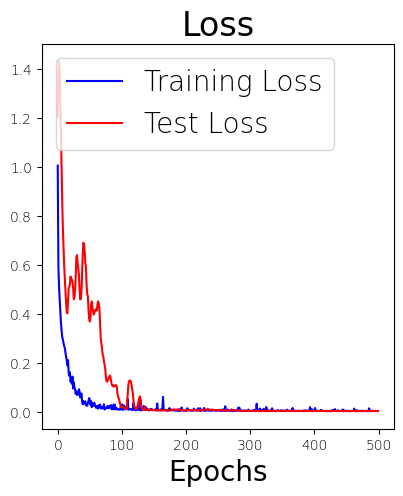

In [191]:
mirrored_strategy = tf.distribute.MirroredStrategy(devices=["/GPU:1"])

w_len = 50
dw = 25
mdl, training_history = train_model(X_train, y_train, X_val, y_val,w_len,dw,500,'/home/jeonggyu/workspace/data/RamanNet',mirrored_strategy)

In [192]:

X_train_seg = segment_spectrum_batch(X_train, w_len, dw)
X_val_seg  = segment_spectrum_batch(X_val, w_len, dw)
X_test_seg  = segment_spectrum_batch(X_test, w_len, dw)
print(len(X_train_seg),len(y_train))
print(X_train_seg[0].shape)

y_test_argmax = np.argmax(y_test,axis=1)
y_train_argmax = np.argmax(y_train,axis=1)
y_val_argmax = np.argmax(y_val,axis=1)

39 1524
(1524, 50)


In [193]:
mdl.summary()

Model: "model_6"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_40 (InputLayer)          [(None, 50)]         0           []                               
                                                                                                  
 input_41 (InputLayer)          [(None, 50)]         0           []                               
                                                                                                  
 input_42 (InputLayer)          [(None, 50)]         0           []                               
                                                                                                  
 input_43 (InputLayer)          [(None, 50)]         0           []                               
                                                                                            

 dense_42 (Dense)               (None, 25)           1275        ['input_41[0][0]']               
                                                                                                  
 dense_43 (Dense)               (None, 25)           1275        ['input_42[0][0]']               
                                                                                                  
 dense_44 (Dense)               (None, 25)           1275        ['input_43[0][0]']               
                                                                                                  
 dense_45 (Dense)               (None, 25)           1275        ['input_44[0][0]']               
                                                                                                  
 dense_46 (Dense)               (None, 25)           1275        ['input_45[0][0]']               
                                                                                                  
 dense_47 

 ormalization)                                                                                    
                                                                                                  
 batch_normalization_44 (BatchN  (None, 25)          100         ['dense_44[0][0]']               
 ormalization)                                                                                    
                                                                                                  
 batch_normalization_45 (BatchN  (None, 25)          100         ['dense_45[0][0]']               
 ormalization)                                                                                    
                                                                                                  
 batch_normalization_46 (BatchN  (None, 25)          100         ['dense_46[0][0]']               
 ormalization)                                                                                    
          

 batch_normalization_71 (BatchN  (None, 25)          100         ['dense_71[0][0]']               
 ormalization)                                                                                    
                                                                                                  
 batch_normalization_72 (BatchN  (None, 25)          100         ['dense_72[0][0]']               
 ormalization)                                                                                    
                                                                                                  
 batch_normalization_73 (BatchN  (None, 25)          100         ['dense_73[0][0]']               
 ormalization)                                                                                    
                                                                                                  
 batch_normalization_74 (BatchN  (None, 25)          100         ['dense_74[0][0]']               
 ormalizat

 re_lu_69 (ReLU)                (None, 25)           0           ['batch_normalization_69[0][0]'] 
                                                                                                  
 re_lu_70 (ReLU)                (None, 25)           0           ['batch_normalization_70[0][0]'] 
                                                                                                  
 re_lu_71 (ReLU)                (None, 25)           0           ['batch_normalization_71[0][0]'] 
                                                                                                  
 re_lu_72 (ReLU)                (None, 25)           0           ['batch_normalization_72[0][0]'] 
                                                                                                  
 re_lu_73 (ReLU)                (None, 25)           0           ['batch_normalization_73[0][0]'] 
                                                                                                  
 re_lu_74 

                                                                                                  
 classification (Dense)         (None, 4)            1028        ['dropout_5[0][0]']              
                                                                                                  
Total params: 688,765
Trainable params: 685,279
Non-trainable params: 3,486
__________________________________________________________________________________________________


In [194]:
mdl(X_train_seg)[1].shape
#mdl(np.array(X_train_seg))[1].shape

TensorShape([1524, 4])

In [195]:
def accuracy(mdl,X,y,w_len,dw):
    X = segment_spectrum_batch(X, w_len, dw)
    predict = np.argmax(mdl(X)[1],axis=1)
    y = np.argmax(y,axis=1)
    unique, counts = np.unique(y - predict, return_counts = True)
    print('predict : ', predict)
    print('y : ', y)
    uniq_cnt_dict = dict(zip(unique, counts))
    print("accuracy = {}%\n{}".format(uniq_cnt_dict[0]/len(y)*100,uniq_cnt_dict))
    return uniq_cnt_dict, predict, y

In [196]:
result_train,predict_train, y_train = accuracy(mdl,X_train,y_train,w_len,dw)
result_val, predict_val, y_val = accuracy(mdl,X_val,y_val,w_len,dw)
result_test, predict_test, y_test = accuracy(mdl,X_test,y_test,w_len,dw)

predict :  [2 0 0 ... 0 0 2]
y :  [2 0 0 ... 0 0 2]
accuracy = 1.0%
{0: 1524}
predict :  [2 2 3 2 1 1 1 0 1 0 3 2 2 1 0 3 2 2 3 3 2 2 3 2 1 3 1 0 2 1 0 3 0 3 2 1 0
 3 1 2 0 2 2 3 3 2 1 3 0 1 0 2 0 2 2 1 0 1 0 3 0 1 2 2 2 1 0 3 1 2 1 0 2 2
 3 1 3 2 1 0 3 3 3 3 0 3 2 0 1 0 0 3 3 1 1 3 3 0 3 1 1 0 2 0 2 1 1 3 0 3 0
 1 3 1 1 3 3 2 3 1 2 1 3 2 3 1 1 1 2 2 1 0 0 0 0 1 0 1 2 1 3 1 3 0 2 0 2 0
 2 3 0 0 0 1 3 2 2 2 0 2 0 3 2 1 2 1 3 3 1 1 3 2 1 2 3 3 0 1 2 0 2 0 3 2 0
 0 3 1 2 2 3 0 2 1 2 1 2 0 2 0 0 1 1 2 2 2 1 3 1 3 3 2 0 2 1 2 0 1 0 3 0 3
 1 3 0 0 2 1 0 0 0 3 2 3 2 1 1 0 2 1 0 3 3 3 3 0 2 0 3 3 2 1 2 1 2 3 0 1 2
 1 2 2 2 0 0 2 0 1 1 2 3 0 0 1 2 1 0 1 2 1 2 2 1 2 0 3 0 1 0 1 0 2 3 3 0 1
 2 3 0 3 1 0 2 3 2 2 3 2 2 2 1 2 3 0 2 0 2 2 2 1 1 3 2 2 3 0 3 2 2 3 0 3 0
 2 2 2 1 0 1 3 2 1 0 0 2 1 3 1 2 3 3 3 3 1 3 3 2 3 2 2 0 1 2 2 1 2 0 0 2 1
 1 0 1 1 3 0 1 2 0 2 2 2 2 2 2 3 2 3 1 1 2 3 3 1 3 2 1 1 0 3 1 3 0 0 3 2 2
 0 1 3 0 3 3 1 1 3 1 0 3 3 1 3 3 2 3 0 0 3 0 1 3 3 0 2 1 2 0 0 3 3 3 0 0 2
 3 1 2 0 2 

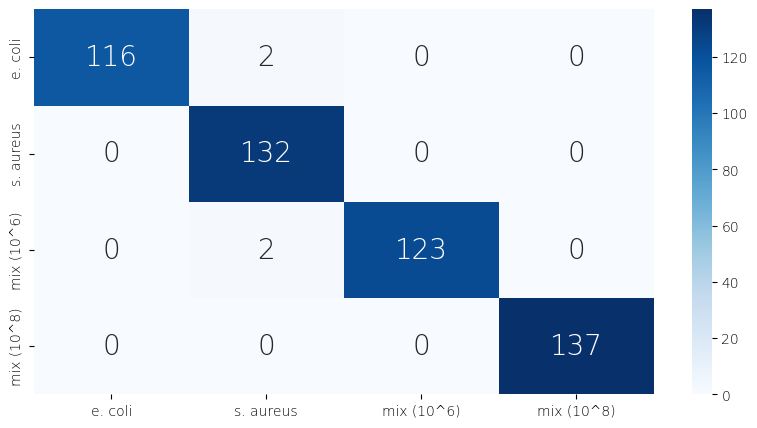

In [197]:
import numpy as np
from sklearn.metrics import confusion_matrix
import seaborn as sns
confusion_matrix(y_test,predict_test)

cm = confusion_matrix(y_test, predict_test)
f = sns.heatmap(cm, annot=True,cmap='Blues', fmt='g',xticklabels=labels,yticklabels=labels)

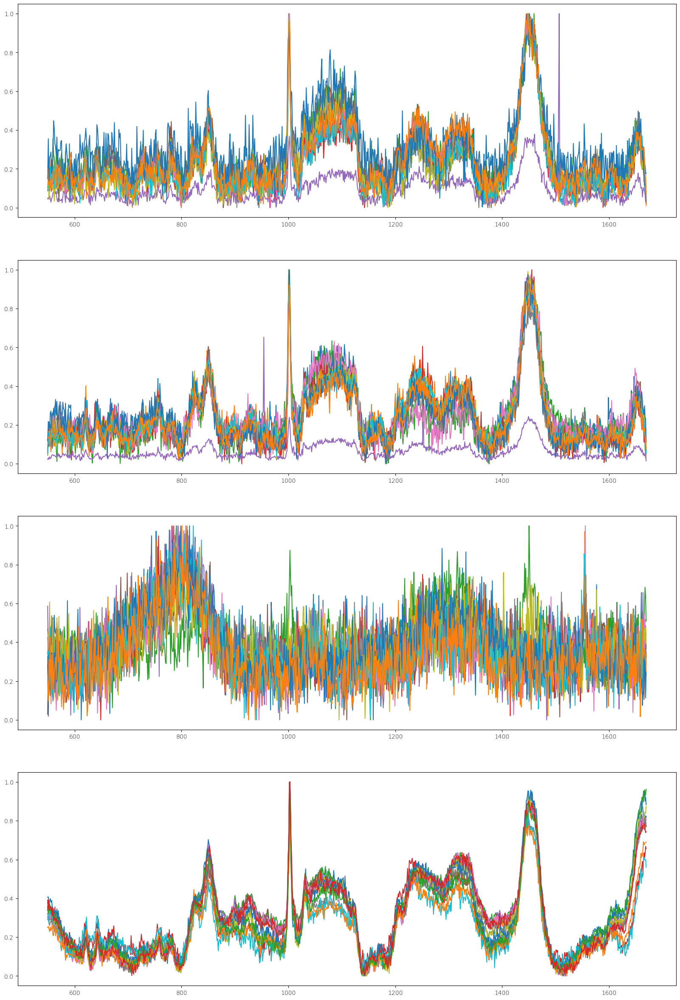

In [198]:
from matplotlib import pyplot as plt 
#plt.rcParams["figure.figsize"]=10,10
font = {'family' : 'normal',
        'weight' : 'light',
        'size'   : 20}

plt.rc('font', **font)

#vmin=np.min(weights)+np.min(biases)           
#vmax=np.max(weights)+np.max(biases)

fig,axs=plt.subplots(len(labels),1,figsize=(20,30))
for i in range(50):
    axs[y_test[i]].plot(wavenum,X_test[i])
    #axs[y_test[i]].set_ylim([-0.02,1.1])
plt.show()

# SHAP

In [199]:
print(X_test_seg[0].shape)
#plt.plot(X_test_seg[0][0],label='1')
#plt.plot(X_test_seg[2][0],label='2')
#plt.plot(X_test_seg[4][0],label='3')
#plt.plot(X_test_seg[6][0],label='4')
#plt.legend()
tt = np.array(X_test_seg).swapaxes(0,1)
print(tt.shape)
t2=tt[:1]
t3=t2.reshape(len(X_test_seg),-1,50)
print(t3.shape)
t3 = list(t3)
print(len(t3))
t4=[]
for i in range(len(X_test_seg)):
    t4.append(np.array(t3[i]))
print(t3[0].shape)

(512, 50)
(512, 39, 50)
(39, 1, 50)
39
(1, 50)


In [208]:
y_test[0:10]

array([2, 3, 3, 1, 1, 2, 0, 1, 1, 3])

In [200]:
print(len(t4))
print(np.array(t4).shape)
print(type(t4))
#plt.plot(t4[0][0],label='1')
#plt.plot(t4[0][2],label='2')
#plt.plot(t4[0][4],label='3')
#plt.plot(t4[0][6],label='4')
#plt.legend()

39
(39, 1, 50)
<class 'list'>


In [201]:
import shap
#shap.initjs()

#shap.explainers._deep.deep_tf.op_handlers["LeakyRelu"] = shap.explainers._deep.deep_tf.passthrough 
#this solves the "shap_ADDV2" problem but another one will appear
#shap.explainers._deep.deep_tf.op_handlers["AddV2"] = shap.explainers._deep.deep_tf.passthrough 
#this solves the next problem which allows you to run the DeepExplainer.
#e = shap.DeepExplainer(model, images)


simple_model_only_first_output = tf.keras.Model(
    inputs=mdl.inputs,
    outputs=mdl.outputs[1],  # specifying a single output for shap usage
)


# since we have two inputs we pass a list of inputs to the explainer
explainer = shap.GradientExplainer(simple_model_only_first_output, X_train_seg)

# we explain the model's predictions on the first three samples of the test set
#shap_values = explainer.shap_values(t4)
shap_values = explainer.shap_values(X_test_seg)

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


In [269]:
print(len(shap_values))
print(len(shap_values[0]))
print(np.array(shap_values).shape)
print(np.array(t4).shape)

4
39
(4, 39, 512, 50)
(39, 1, 50)


In [260]:
type(shap_values[0][0])

numpy.ndarray

In [211]:
shap_each_class = []
for c in range(len(labels)):
    i_l = []
    for i in range(len(X_test_seg)):
        f_l = []
        for j in range(50):
            f_l.append(np.sum(shap_values[c][i][:,j]))
        i_l.append(f_l)
    shap_each_class.append(i_l)
    print(c)
shap_each_class = np.array(shap_each_class)
print(shap_each_class[0])
print(shap_each_class.shape)

0
1
2
3
[[-0.10960093 -0.22947819 -0.2563448  ...  0.02227933  0.03986215
   0.05506622]
 [-0.00890786 -0.02231438 -0.07039626 ...  0.03349659  0.01882549
  -0.00266317]
 [-0.01741123  0.0223686  -0.04661894 ... -0.06115039 -0.12186506
  -0.00710133]
 ...
 [-0.01043596  0.00939785  0.00566799 ... -0.01535238 -0.00921201
   0.01060553]
 [-0.01369671 -0.01799268 -0.01486455 ...  0.01571354  0.01105263
  -0.05505096]
 [-0.0238467  -0.03472752 -0.02685956 ...  0.01876321  0.00236828
   0.02144829]]
(4, 39, 50)


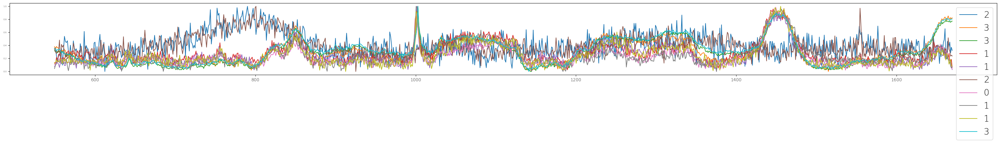

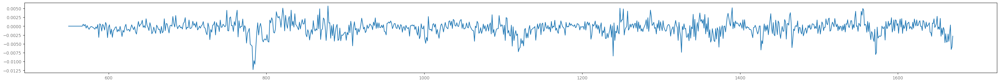

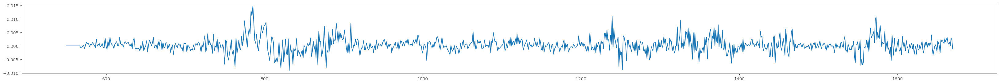

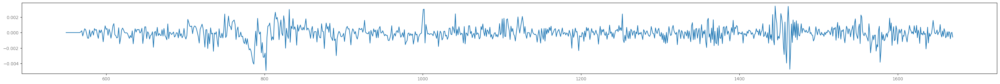

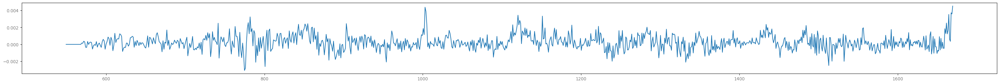

In [212]:
import matplotlib

plt.rcParams["figure.figsize"]=41,3

matplotlib.rc('xtick', labelsize=10) 
matplotlib.rc('ytick', labelsize=10) 

for i in range(10):
    plt.plot(wavenum,X_test[i],label=y_test[i])
    plt.tick_params(axis='y',labelsize=5)
plt.legend()
plt.show()

shap_vals = []

for c in range(len(labels)):
    shap_val=np.zeros(len(wavenum))
    shap_mask=np.zeros(len(wavenum))
    for i in range(len(X_test_seg)):
        shap_val[i*25:i*25+50] = (shap_val[i*25:i*25+50]+shap_each_class[c][i])
        shap_mask += 1
    shap_vals.append(shap_val/shap_mask)
    plt.plot(wavenum,shap_vals[-1])
    #plt.xlim(,1015)
    plt.show()



In [213]:
np.array(t4).shape

(39, 1, 50)

In [214]:
x_tensor_list = []
for i in range(39):
    x_tensor_list.append(tf.convert_to_tensor(t4[i], dtype=tf.float32))


In [129]:
mdl.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 50)]         0           []                               
                                                                                                  
 input_2 (InputLayer)           [(None, 50)]         0           []                               
                                                                                                  
 input_3 (InputLayer)           [(None, 50)]         0           []                               
                                                                                                  
 input_4 (InputLayer)           [(None, 50)]         0           []                               
                                                                                              

 dense_1 (Dense)                (None, 25)           1275        ['input_2[0][0]']                
                                                                                                  
 dense_2 (Dense)                (None, 25)           1275        ['input_3[0][0]']                
                                                                                                  
 dense_3 (Dense)                (None, 25)           1275        ['input_4[0][0]']                
                                                                                                  
 dense_4 (Dense)                (None, 25)           1275        ['input_5[0][0]']                
                                                                                                  
 dense_5 (Dense)                (None, 25)           1275        ['input_6[0][0]']                
                                                                                                  
 dense_6 (

 rmalization)                                                                                     
                                                                                                  
 batch_normalization_3 (BatchNo  (None, 25)          100         ['dense_3[0][0]']                
 rmalization)                                                                                     
                                                                                                  
 batch_normalization_4 (BatchNo  (None, 25)          100         ['dense_4[0][0]']                
 rmalization)                                                                                     
                                                                                                  
 batch_normalization_5 (BatchNo  (None, 25)          100         ['dense_5[0][0]']                
 rmalization)                                                                                     
          

 batch_normalization_30 (BatchN  (None, 25)          100         ['dense_30[0][0]']               
 ormalization)                                                                                    
                                                                                                  
 batch_normalization_31 (BatchN  (None, 25)          100         ['dense_31[0][0]']               
 ormalization)                                                                                    
                                                                                                  
 batch_normalization_32 (BatchN  (None, 25)          100         ['dense_32[0][0]']               
 ormalization)                                                                                    
                                                                                                  
 batch_normalization_33 (BatchN  (None, 25)          100         ['dense_33[0][0]']               
 ormalizat

 re_lu_28 (ReLU)                (None, 25)           0           ['batch_normalization_28[0][0]'] 
                                                                                                  
 re_lu_29 (ReLU)                (None, 25)           0           ['batch_normalization_29[0][0]'] 
                                                                                                  
 re_lu_30 (ReLU)                (None, 25)           0           ['batch_normalization_30[0][0]'] 
                                                                                                  
 re_lu_31 (ReLU)                (None, 25)           0           ['batch_normalization_31[0][0]'] 
                                                                                                  
 re_lu_32 (ReLU)                (None, 25)           0           ['batch_normalization_32[0][0]'] 
                                                                                                  
 re_lu_33 

                                                                                                  
 classification (Dense)         (None, 3)            771         ['dropout_2[0][0]']              
                                                                                                  
Total params: 688,508
Trainable params: 685,022
Non-trainable params: 3,486
__________________________________________________________________________________________________


In [215]:
with tf.GradientTape() as t:
    t.watch(x_tensor_list)
    output = mdl(x_tensor_list) # 39 x 1 x 50
    result = output
    gradients = t.gradient(output[1][0][2], x_tensor_list)

In [216]:
output[1][0][0]

<tf.Tensor: shape=(), dtype=float32, numpy=1.2359086e-09>

In [217]:
y_test[0]

2

In [218]:
print(np.array(gradients).shape)

print(gradients[0][0][0])

(39, 1, 50)
tf.Tensor(9.543741e-10, shape=(), dtype=float32)


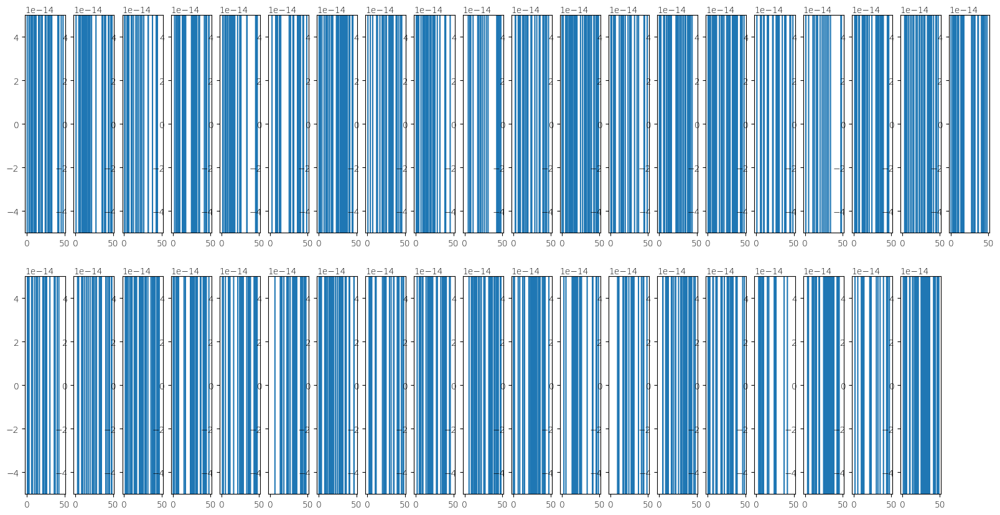

In [219]:
plt.rcParams["figure.figsize"]=20,10

j = 1
k = 21
odd=[]
even=[]
for i in range(39):
    if i%2 == 0:
        plt.subplot(2,20,j)
        plt.plot(gradients[i][0],label='1')
        odd.append(gradients[i][0])
        j = j+1
        plt.ylim(-5*1e-14,5*1e-14)
    else :
        plt.subplot(2,20,k)
        plt.plot(gradients[i][0],label='1')
        even.append(gradients[i][0])
        k = k+1 
        plt.ylim(-5*1e-14,5*1e-14)
plt.show()


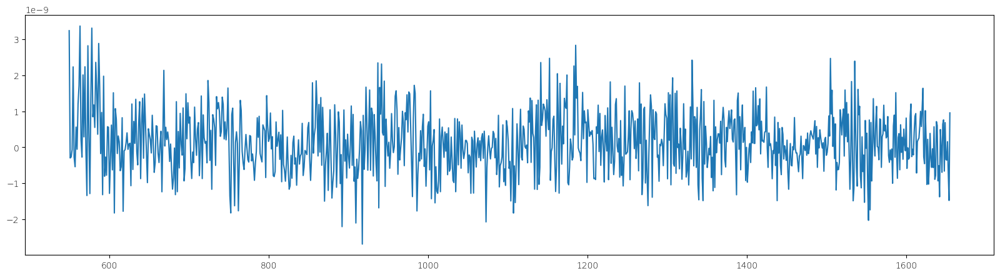

In [225]:
plt.rcParams["figure.figsize"]=20,5 
odd = np.array(odd).reshape(20*50)
plt.plot(wavenum[15:],odd)

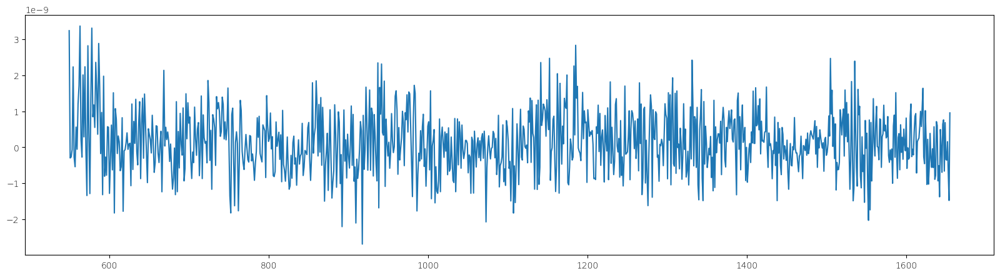

In [226]:
even = np.array(even).reshape(19*50)
plt.plot(wavenum[15:],odd)

In [298]:
[X_train[:,i:i+50] for i in range(0,X_train.shape[1]-50,25)][0][0]

array([0.6754432 , 0.87604229, 0.7012737 , 0.37676728, 0.53381272,
       0.4661745 , 0.74077108, 0.54481267, 0.54134692, 0.69819576,
       0.68401232, 0.81940023, 0.67702058, 0.79099435, 0.54190498,
       0.54910932, 0.54563658, 0.25405917, 0.41066998, 0.54588408,
       0.5210804 , 0.52827092, 0.39687918, 0.32948426, 0.40063707,
       0.4291457 , 0.42568714, 0.23054358, 0.31229795, 0.33014836,
       0.49698755, 0.35518032, 0.49002696, 0.30572822, 0.2172081 ,
       0.2882011 , 0.42294153, 0.24942112, 0.35223222, 0.49749239,
       0.06914091, 0.51172832, 0.47636855, 0.17564749, 0.28894009,
       0.47645656, 0.30320721, 0.39518052, 0.35986298, 0.33515768])

In [308]:
print( [i for i in range(0,1015-50,25)])

[0, 25, 50, 75, 100, 125, 150, 175, 200, 225, 250, 275, 300, 325, 350, 375, 400, 425, 450, 475, 500, 525, 550, 575, 600, 625, 650, 675, 700, 725, 750, 775, 800, 825, 850, 875, 900, 925, 950]


In [441]:
y_test.shape

(512, 4)

In [439]:
np.argmax(y_test,axis=1)

array([2, 3, 3, 1, 1, 2, 0, 1, 1, 3, 1, 2, 1, 3, 0, 3, 0, 2, 3, 1, 3, 0,
       2, 3, 3, 3, 2, 1, 3, 1, 1, 1, 3, 0, 2, 2, 3, 0, 0, 2, 0, 3, 0, 1,
       2, 2, 2, 0, 0, 0, 3, 2, 2, 0, 2, 1, 2, 2, 2, 2, 0, 2, 0, 0, 0, 3,
       2, 3, 3, 1, 3, 2, 2, 3, 3, 0, 3, 3, 0, 2, 3, 2, 1, 1, 3, 2, 1, 1,
       0, 3, 3, 0, 2, 2, 2, 0, 3, 0, 0, 2, 3, 0, 1, 1, 0, 0, 1, 3, 1, 1,
       2, 2, 1, 2, 1, 3, 1, 2, 1, 0, 2, 1, 3, 0, 1, 3, 1, 1, 1, 3, 1, 1,
       3, 1, 2, 0, 1, 1, 2, 2, 1, 3, 1, 3, 0, 3, 0, 3, 1, 0, 1, 0, 0, 2,
       0, 2, 2, 3, 2, 3, 0, 0, 0, 1, 2, 3, 3, 3, 0, 1, 2, 1, 3, 3, 0, 0,
       1, 1, 1, 2, 0, 1, 0, 3, 0, 0, 0, 3, 0, 1, 0, 3, 3, 1, 0, 2, 1, 0,
       0, 3, 3, 0, 2, 0, 2, 0, 1, 0, 1, 0, 0, 3, 3, 3, 1, 1, 1, 3, 3, 3,
       0, 3, 2, 1, 0, 1, 1, 0, 1, 3, 3, 0, 1, 3, 3, 0, 2, 2, 2, 3, 1, 0,
       1, 1, 0, 1, 2, 1, 0, 0, 3, 1, 2, 0, 0, 0, 3, 2, 3, 1, 0, 1, 3, 1,
       0, 2, 0, 2, 3, 1, 2, 1, 1, 1, 1, 1, 2, 0, 1, 0, 3, 1, 0, 0, 0, 2,
       1, 3, 2, 0, 3, 2, 2, 3, 2, 2, 1, 2, 2, 3, 1,

# Shapely values of all data (Non-average of each raman shift) 

(4, 512, 1015)


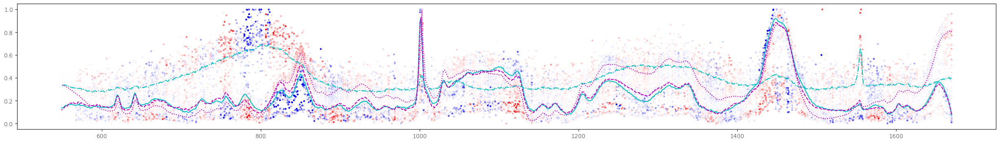

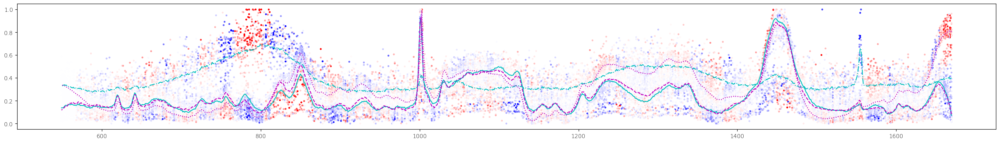

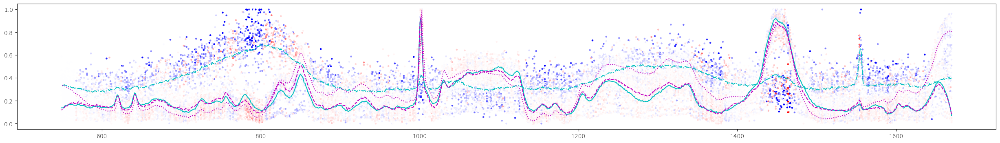

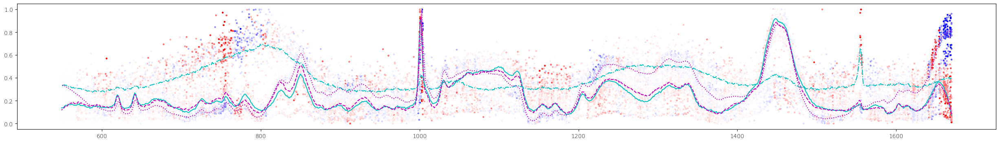

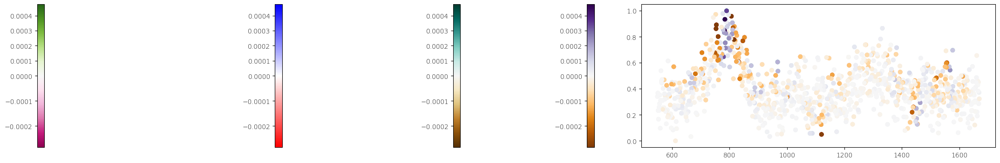

In [480]:

from matplotlib import cm
import matplotlib.colors as colors

plt.rcParams["figure.figsize"]=31,4
matplotlib.rc('xtick', labelsize=10) 
matplotlib.rc('ytick', labelsize=10) 
#plt.plot(X_test[0])
#plt.tick_params(axis='y',labelsize=5)
#plt.show()

shap_vals_c = []

for c in range(len(labels)):
    shap_vals = []
    for d in range(shap_values[c][i].shape[0]):
        shap_val=np.zeros(len(wavenum))
        shap_mask=np.zeros(len(wavenum))
        for i in range(len(X_test_seg)):
            shap_val[i*25:i*25+50] = (shap_val[i*25:i*25+50]+shap_values[c][i][d])
            shap_mask += 1
        shap_vals.append(shap_val/shap_mask)
    shap_vals_c.append(shap_vals)
    #plt.plot(shap_vals[-1])
    #plt.xlim(,1015)
    #plt.show()
    
print(np.array(shap_vals_c).shape)

'''
    for t in range(20):
        scale = 1e+8
        vmin = np.min(shap_vals[-1]*scale)
        vmax = np.max(shap_vals[-1]*scale)
        norm = colors.TwoSlopeNorm(vmin=vmin, vcenter=0, vmax=vmax)
        plt.scatter(wavenum,X_test[t],s=5,c=shap_vals[c]*scale,cmap='bwr_r',norm=norm)#,norm=matplotlib.colors.LogNorm())
        plt.colorbar()
        plt.title('data_'+str(t)+' class_'+str(y_test[t])+' pred_'+str(predict_test[t])+' SHAP in class_'+str(c))
        plt.show()
'''

threshold_ratio = 0.3

cmap_list = ['PiYG','bwr_r','BrBG','PuOr']
y_argmax = np.argmax(y_test,axis=1)

for c in range(len(labels)):
    vmin = np.min(shap_vals_c[c])*threshold_ratio
    vmax = np.max(shap_vals_c[c])*threshold_ratio
    for t in range(len(X_test_seg)):
        norm = colors.TwoSlopeNorm(vmin=vmin, vcenter=0, vmax=vmax)
        plt.scatter(wavenum,X_test[t],s=5,c=shap_vals_c[c][t],cmap='bwr_r',norm=norm)#,norm=matplotlib.colors.LogNorm())
        #plt.scatter(wavenum,X_test[t],s=5,c=shap_vals_c[c][t],cmap=cmap_list[y_argmax[t]],norm=norm)#,norm=matplotlib.colors.LogNorm())
    #plt.colorbar()
    #plt.plot(wavenum,np.average(X_cls[c],axis=0),'black')#,norm=matplotlib.colors.LogNorm())
    plt.plot(wavenum,np.average(X_cls[0],axis=0),'c-')#,norm=matplotlib.colors.LogNorm())
    plt.plot(wavenum,np.average(X_cls[1],axis=0),'m--')#,norm=matplotlib.colors.LogNorm())
    plt.plot(wavenum,np.average(X_cls[2],axis=0),'c-.')#,norm=matplotlib.colors.LogNorm())
    plt.plot(wavenum,np.average(X_cls[3],axis=0),'m:')#,norm=matplotlib.colors.LogNorm())
    #plt.scatter(wavenum,np.average(X_cls[c],axis=0),s=2,edgecolors='black')#,norm=matplotlib.colors.LogNorm())
    #plt.title('data_'+str(t)+' class_'+str(y_test[t])+' pred_'+str(predict_test[t])+' SHAP in class_'+str(c))
    plt.show()

for cmap in range(len(cmap_list)):
    plt.scatter(wavenum,X_test[0],c=shap_vals_c[0][0],cmap=cmap_list[cmap],norm=norm)#,norm=matplotlib.colors.LogNorm())
    plt.colorbar(location='left')
plt.show()

(4, 512, 1015)


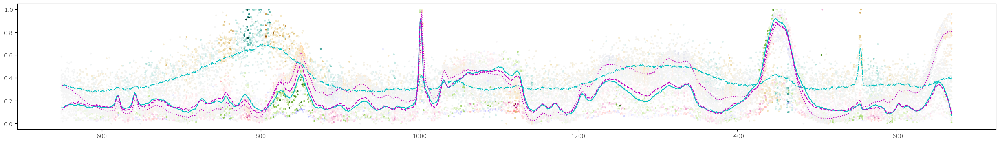

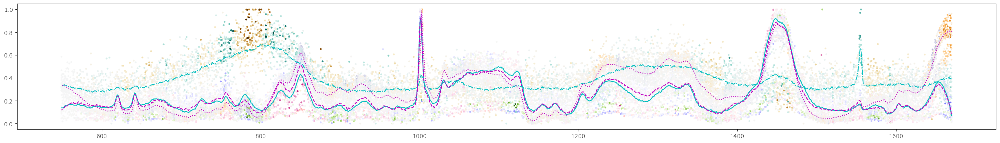

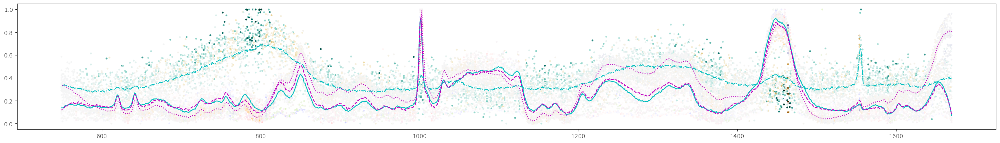

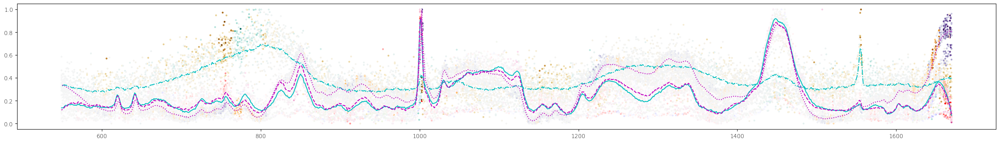

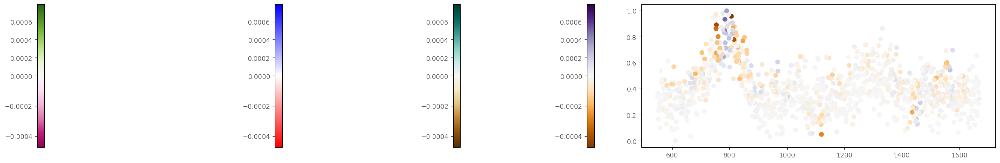

In [479]:

from matplotlib import cm
import matplotlib.colors as colors

plt.rcParams["figure.figsize"]=31,4
matplotlib.rc('xtick', labelsize=10) 
matplotlib.rc('ytick', labelsize=10) 
#plt.plot(X_test[0])
#plt.tick_params(axis='y',labelsize=5)
#plt.show()

shap_vals_c = []

for c in range(len(labels)):
    shap_vals = []
    for d in range(shap_values[c][i].shape[0]):
        shap_val=np.zeros(len(wavenum))
        shap_mask=np.zeros(len(wavenum))
        for i in range(len(X_test_seg)):
            shap_val[i*25:i*25+50] = (shap_val[i*25:i*25+50]+shap_values[c][i][d])
            shap_mask += 1
        shap_vals.append(shap_val/shap_mask)
    shap_vals_c.append(shap_vals)
    #plt.plot(shap_vals[-1])
    #plt.xlim(,1015)
    #plt.show()
    
print(np.array(shap_vals_c).shape)

'''
    for t in range(20):
        scale = 1e+8
        vmin = np.min(shap_vals[-1]*scale)
        vmax = np.max(shap_vals[-1]*scale)
        norm = colors.TwoSlopeNorm(vmin=vmin, vcenter=0, vmax=vmax)
        plt.scatter(wavenum,X_test[t],s=5,c=shap_vals[c]*scale,cmap='bwr_r',norm=norm)#,norm=matplotlib.colors.LogNorm())
        plt.colorbar()
        plt.title('data_'+str(t)+' class_'+str(y_test[t])+' pred_'+str(predict_test[t])+' SHAP in class_'+str(c))
        plt.show()
'''

threshold_ratio = 0.5

cmap_list = ['PiYG','bwr_r','BrBG','PuOr']
y_argmax = np.argmax(y_test,axis=1)

for c in range(len(labels)):
    vmin = np.min(shap_vals_c[c])*threshold_ratio
    vmax = np.max(shap_vals_c[c])*threshold_ratio
    for t in range(len(X_test_seg)):
        norm = colors.TwoSlopeNorm(vmin=vmin, vcenter=0, vmax=vmax)
        #plt.scatter(wavenum,X_test[t],s=5,c=shap_vals_c[c][t],cmap='bwr_r',norm=norm)#,norm=matplotlib.colors.LogNorm())
        plt.scatter(wavenum,X_test[t],s=5,c=shap_vals_c[c][t],cmap=cmap_list[y_argmax[t]],norm=norm)#,norm=matplotlib.colors.LogNorm())
    #plt.colorbar()
    #plt.plot(wavenum,np.average(X_cls[c],axis=0),'black')#,norm=matplotlib.colors.LogNorm())
    plt.plot(wavenum,np.average(X_cls[0],axis=0),'c-')#,norm=matplotlib.colors.LogNorm())
    plt.plot(wavenum,np.average(X_cls[1],axis=0),'m--')#,norm=matplotlib.colors.LogNorm())
    plt.plot(wavenum,np.average(X_cls[2],axis=0),'c-.')#,norm=matplotlib.colors.LogNorm())
    plt.plot(wavenum,np.average(X_cls[3],axis=0),'m:')#,norm=matplotlib.colors.LogNorm())
    #plt.scatter(wavenum,np.average(X_cls[c],axis=0),s=2,edgecolors='black')#,norm=matplotlib.colors.LogNorm())
    #plt.title('data_'+str(t)+' class_'+str(y_test[t])+' pred_'+str(predict_test[t])+' SHAP in class_'+str(c))
    plt.show()

for cmap in range(len(cmap_list)):
    plt.scatter(wavenum,X_test[0],c=shap_vals_c[0][0],cmap=cmap_list[cmap],norm=norm)#,norm=matplotlib.colors.LogNorm())
    plt.colorbar(location='left')
plt.show()

# Average of SHAP in a Batch

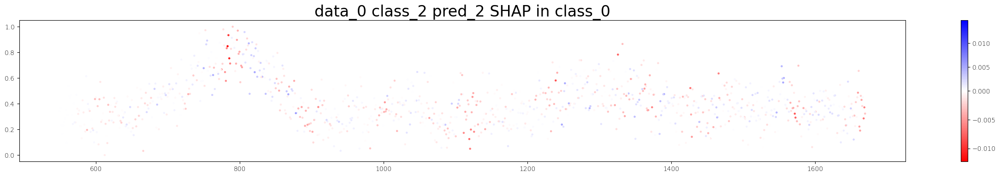

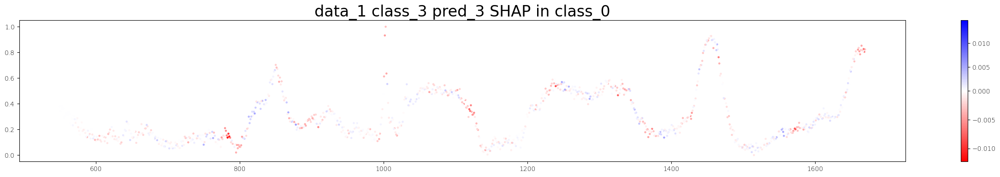

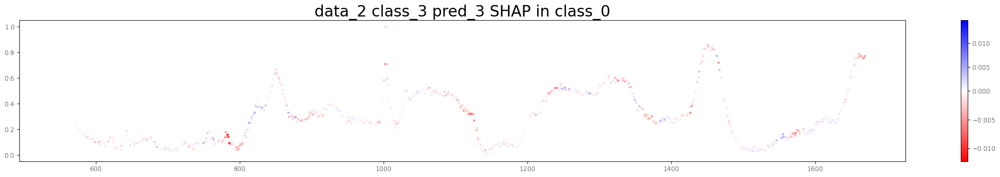

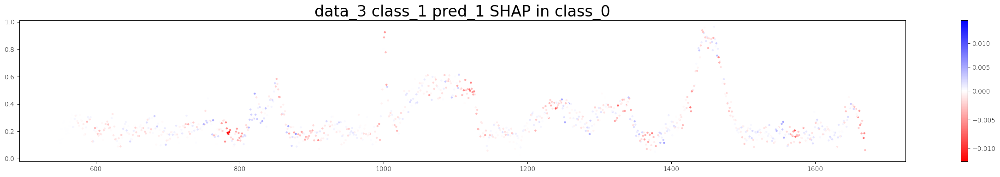

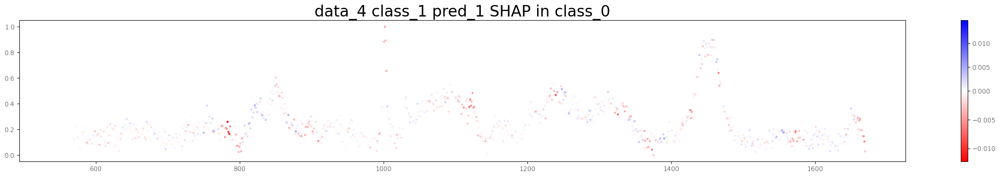

...

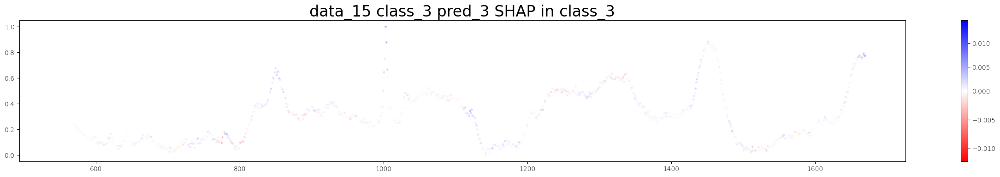

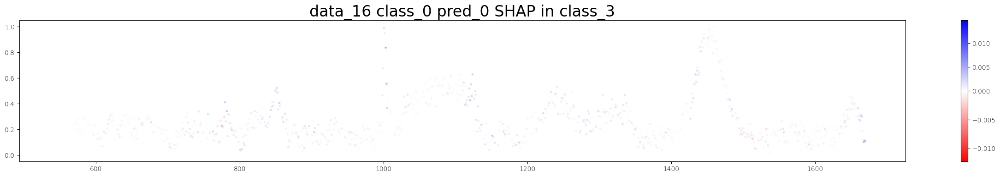

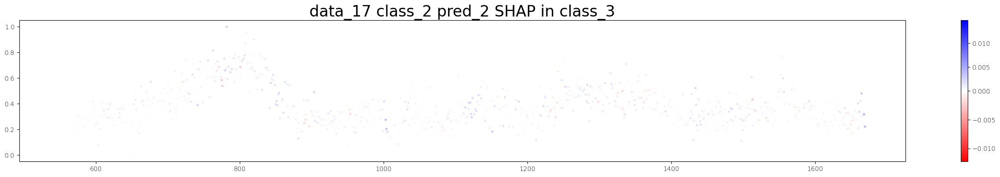

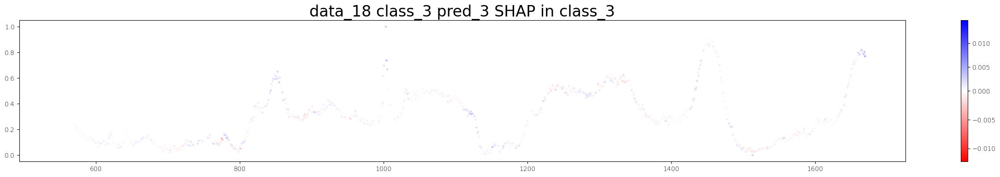

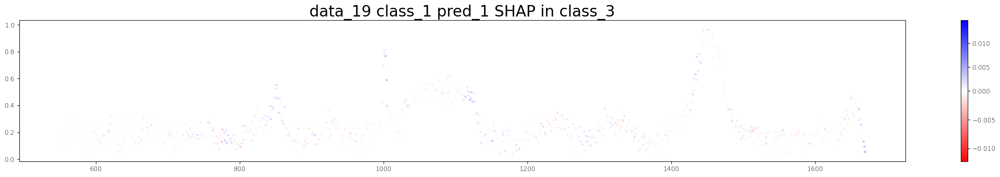

In [244]:

from matplotlib import cm
import matplotlib.colors as colors

plt.rcParams["figure.figsize"]=31,4
matplotlib.rc('xtick', labelsize=10) 
matplotlib.rc('ytick', labelsize=10) 
#plt.plot(X_test[0])
#plt.tick_params(axis='y',labelsize=5)
#plt.show()

shap_vals = []

for c in range(len(labels)):
    shap_val=np.zeros(len(wavenum))
    shap_mask=np.zeros(len(wavenum))
    for i in range(len(X_test_seg)):
        shap_val[i*25:i*25+50] = (shap_val[i*25:i*25+50]+shap_each_class[c][i])
        shap_mask += 1
    shap_vals.append(shap_val/shap_mask)
    #plt.plot(shap_vals[-1])
    #plt.xlim(,1015)
    #plt.show()
    '''
    for t in range(20):
        scale = 1e+8
        vmin = np.min(shap_vals[-1]*scale)
        vmax = np.max(shap_vals[-1]*scale)
        norm = colors.TwoSlopeNorm(vmin=vmin, vcenter=0, vmax=vmax)
        plt.scatter(wavenum,X_test[t],s=5,c=shap_vals[c]*scale,cmap='bwr_r',norm=norm)#,norm=matplotlib.colors.LogNorm())
        plt.colorbar()
        plt.title('data_'+str(t)+' class_'+str(y_test[t])+' pred_'+str(predict_test[t])+' SHAP in class_'+str(c))
        plt.show()
    '''
        
for c in range(len(labels)):
    for t in range(20):
        scale = 1e+8
        vmin = np.min(shap_vals)
        vmax = np.max(shap_vals)
        norm = colors.TwoSlopeNorm(vmin=vmin, vcenter=0, vmax=vmax)
        plt.scatter(wavenum,X_test[t],s=5,c=shap_vals[c],cmap='bwr_r',norm=norm)#,norm=matplotlib.colors.LogNorm())
        plt.colorbar()
        plt.title('data_'+str(t)+' class_'+str(y_test[t])+' pred_'+str(predict_test[t])+' SHAP in class_'+str(c))
        plt.show()

# each SHAP value of a data in a batch

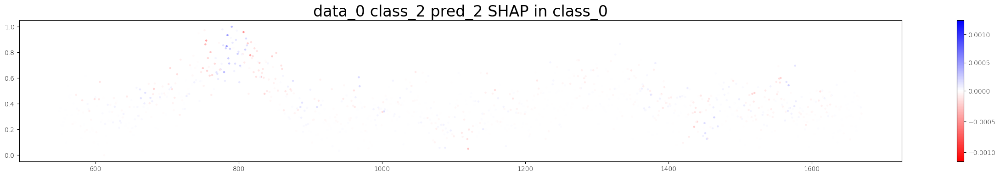

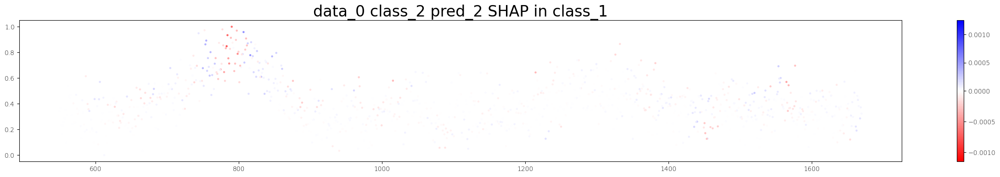

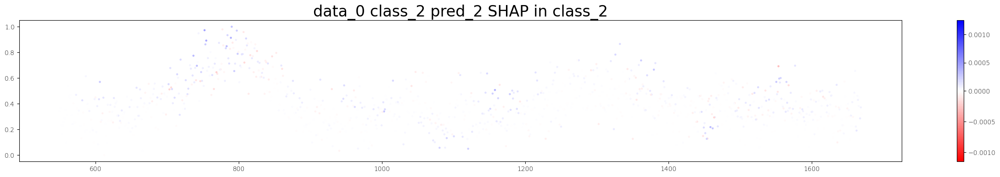

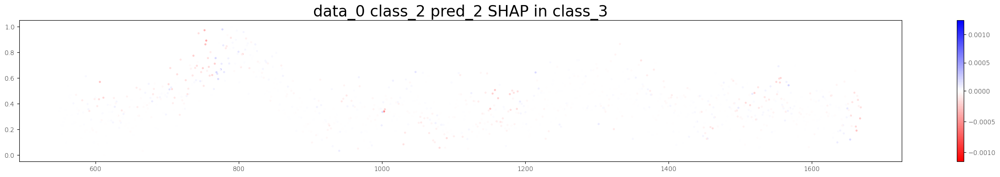

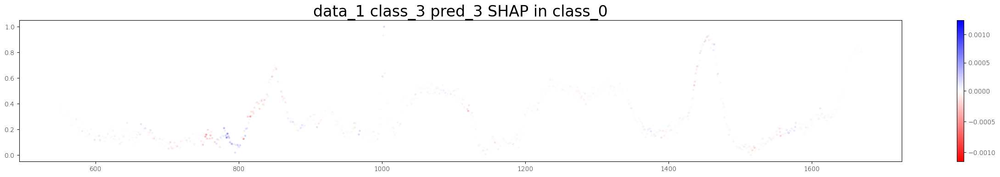

...

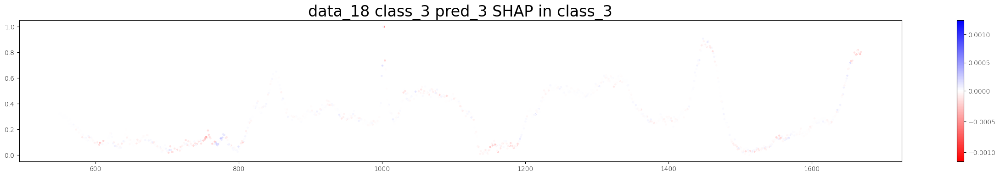

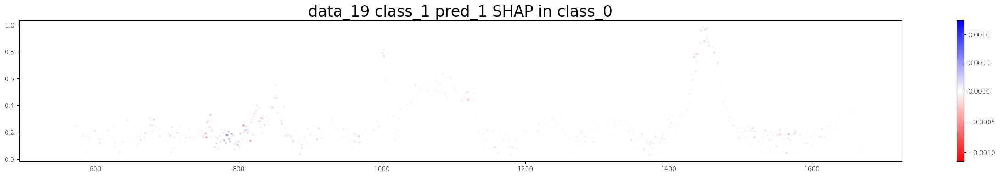

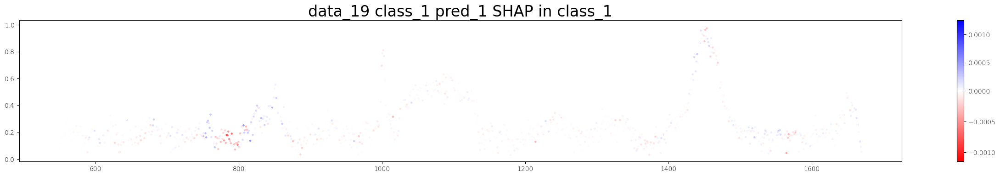

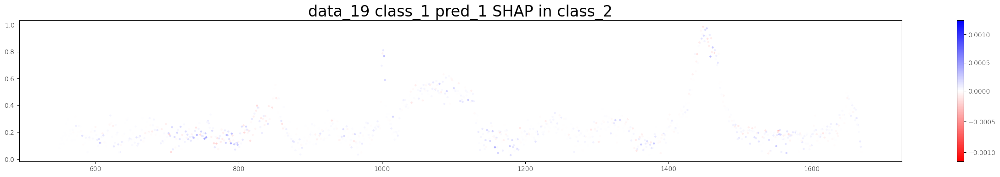

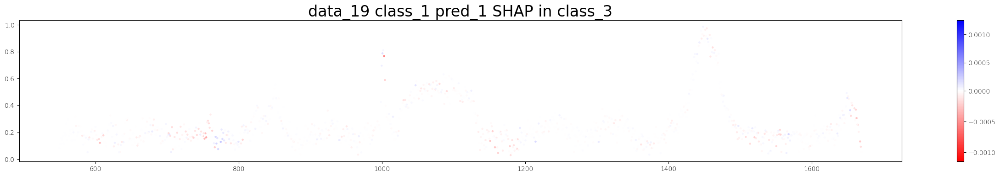

In [245]:
from matplotlib import cm
import matplotlib.colors as colors

plt.rcParams["figure.figsize"]=31,4
matplotlib.rc('xtick', labelsize=10) 
matplotlib.rc('ytick', labelsize=10) 
#plt.plot(X_test[0])
#plt.tick_params(axis='y',labelsize=5)
#plt.show()

shap_vals = []


    
for t in range(20):
    for c in range(len(labels)):
        shap_val=np.zeros(len(wavenum))
        shap_mask=np.zeros(len(wavenum))
        for i in range(len(X_test_seg)):
            shap_val[i*25:i*25+50] = (shap_val[i*25:i*25+50]+shap_values[c][i][t])
            shap_mask += 1
        shap_vals.append(shap_val/shap_mask)
        #plt.plot(shap_vals[-1])
        #plt.xlim(,1015)
        #plt.show()
    
for t in range(20):
    for c in range(len(labels)):        
        scale = 1e+8
        vmin = np.min(shap_vals)
        vmax = np.max(shap_vals)
        norm = colors.TwoSlopeNorm(vmin=vmin, vcenter=0, vmax=vmax)
        plt.scatter(wavenum,X_test[t],s=5,c=shap_vals[c],cmap='bwr_r',norm=norm)#,norm=matplotlib.colors.LogNorm())
        plt.colorbar()
        plt.title('data_'+str(t)+' class_'+str(y_test[t])+' pred_'+str(predict_test[t])+' SHAP in class_'+str(c))
        plt.show()


In [224]:
np.array(shap_values).shape

(4, 39, 512, 50)

In [353]:
np.where(y_test[t]==1)

(array([2]),)

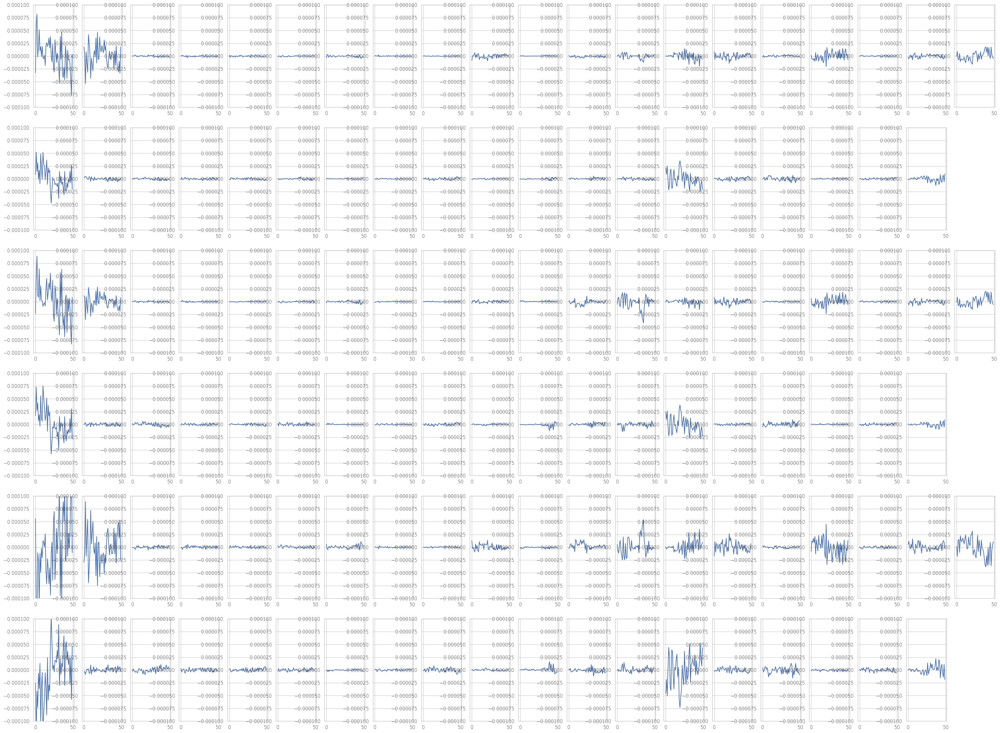

In [167]:
plt.rcParams["figure.figsize"]=40,30

for c in range(3):
    j = 1 + c*40
    k = 21+ c*40
    for i in range(39):
        if i%2 == 0:
            plt.subplot(6,20,j)
            plt.plot(shap_each_class[c][i])
            j = j+1
            plt.ylim(-1e-4,1e-4)
        else :
            plt.subplot(6,20,k)
            plt.plot(shap_each_class[c][i])
            k = k+1 
            plt.ylim(-1e-4,1e-4)
plt.show()



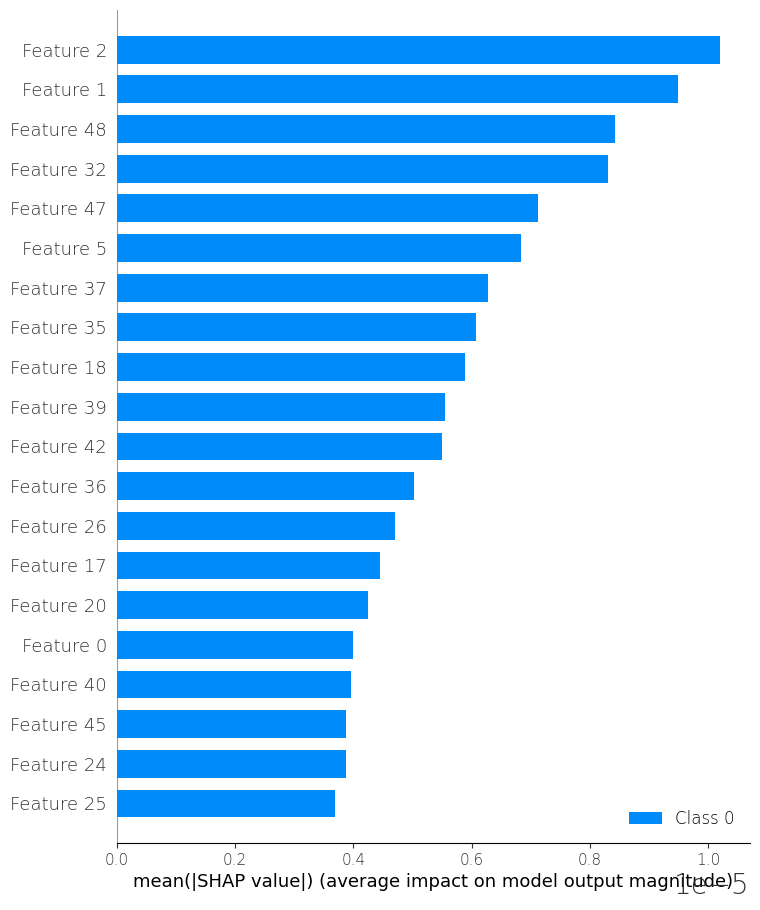

In [75]:
shap.summary_plot([shap_values[0][0]], t4[0])

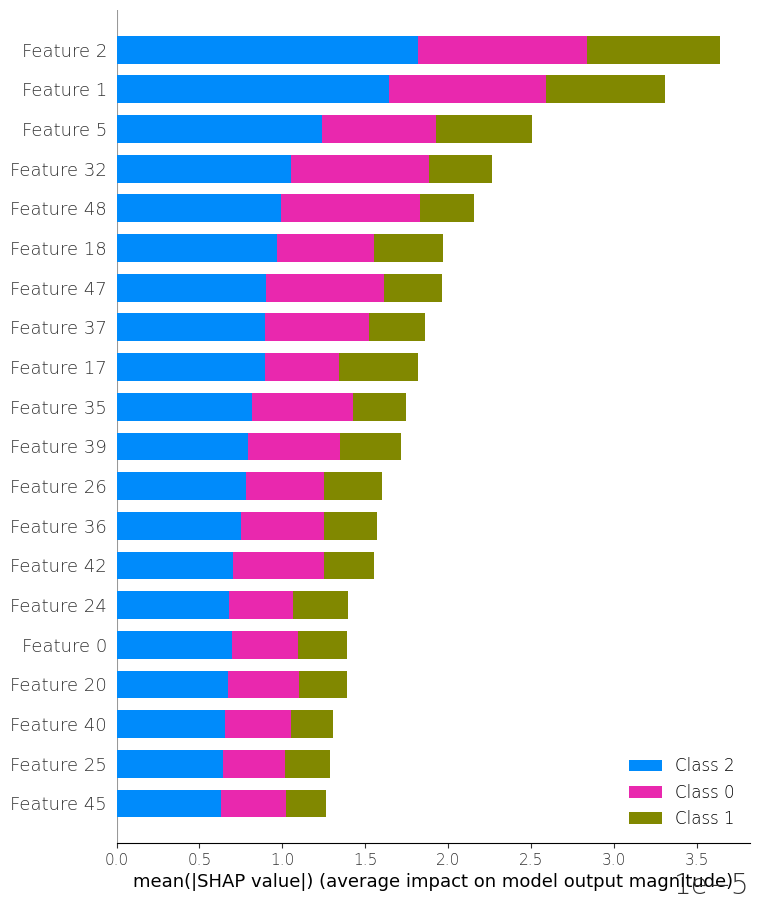

In [85]:
shap.summary_plot([shap_values[i][0] for i in range(3)], t4[0])

In [ ]:
shap.summary_plot([shap_values[i][0] for i in range(3)], t4[0])

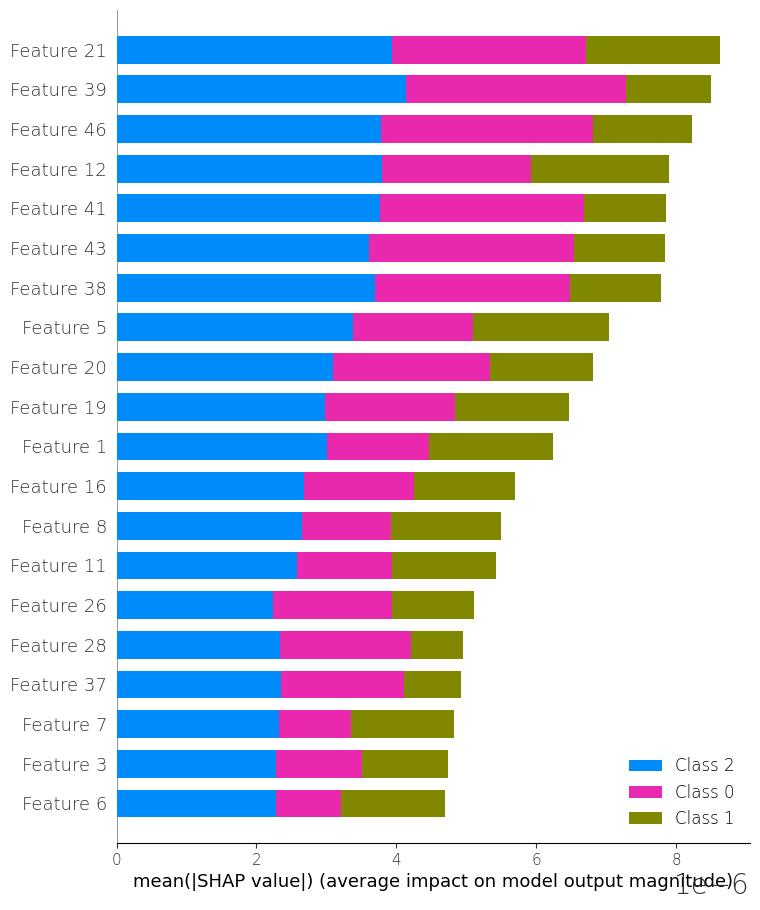

In [62]:
shap.summary_plot([shap_values[i][38] for i in range(3)], t4[0])

In [47]:
shap.force_plot([shap_values[i][0] for i in range(3)], t4[0])

Exception: In v0.20 force_plot now requires the base value as the first parameter! Try shap.force_plot(explainer.expected_value, shap_values) or for multi-output models try shap.force_plot(explainer.expected_value[0], shap_values[0]).

TypeError: Invalid shape (50,) for image data

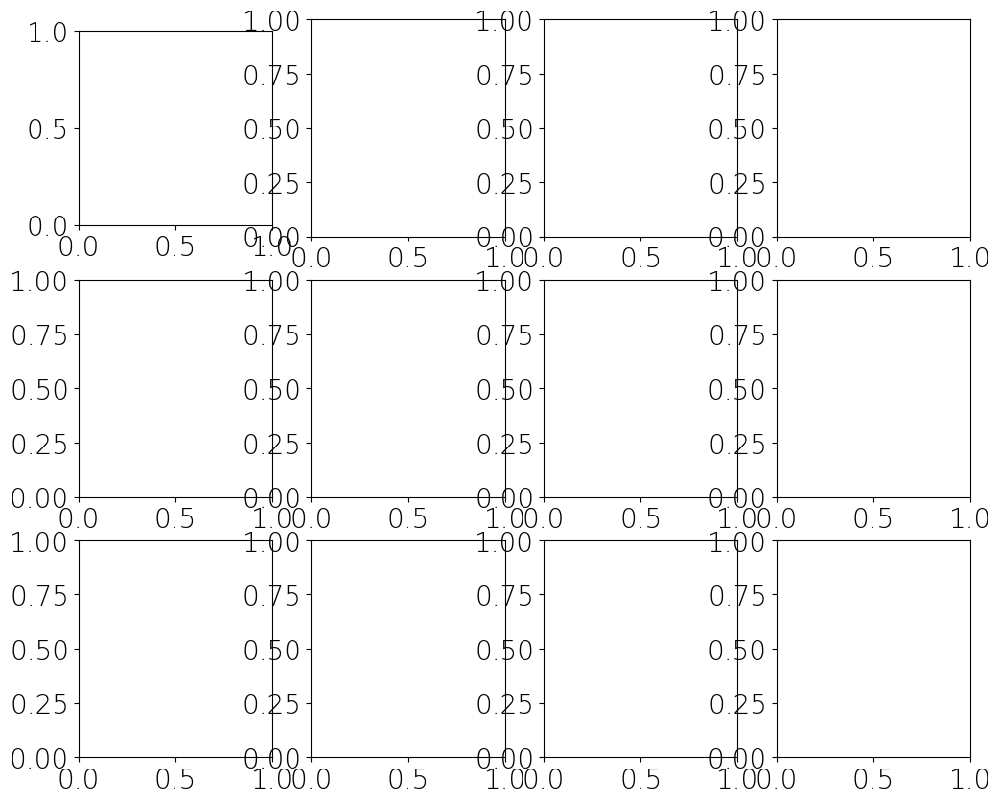

In [46]:
shap.image_plot([shap_values[i][0] for i in range(3)], t4[0])

In [88]:
import tensorflow as tf
from tensorflow.keras import Input
from tensorflow.keras.layers import Flatten, Dense, Dropout, Conv2D

# load the MNIST data
(x_train, y_train), (x_test, y_test) = tf.keras.datasets.mnist.load_data()
x_train, x_test = x_train / 255.0, x_test / 255.0
x_train = x_train.astype('float32')
x_test = x_test.astype('float32')
x_train = x_train.reshape(x_train.shape[0], 28, 28, 1)
x_test = x_test.reshape(x_test.shape[0], 28, 28, 1)

# define our model
input1 = Input(shape=(28,28,1))
input2 = Input(shape=(28,28,1))
input2c = Conv2D(32, kernel_size=(3, 3), activation='relu')(input2)
joint = tf.keras.layers.concatenate([Flatten()(input1), Flatten()(input2c)])
out = Dense(10, activation='softmax')(Dropout(0.2)(Dense(128, activation='relu')(joint)))
model = tf.keras.models.Model(inputs = [input1, input2], outputs=out)

model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

In [89]:
# fit the model
model.fit([x_train, x_train], y_train, epochs=3)

Epoch 1/3


2022-12-07 17:36:01.055131: W tensorflow/core/common_runtime/bfc_allocator.cc:275] Allocator (GPU_0_bfc) ran out of memory trying to allocate 18.64MiB with freed_by_count=0. The caller indicates that this is not a failure, but may mean that there could be performance gains if more memory were available.
2022-12-07 17:36:01.055192: W tensorflow/core/kernels/gpu_utils.cc:50] Failed to allocate memory for convolution redzone checking; skipping this check. This is benign and only means that we won't check cudnn for out-of-bounds reads and writes. This message will only be printed once.
2022-12-07 17:36:01.196008: I tensorflow/stream_executor/cuda/cuda_dnn.cc:368] Loaded cuDNN version 8302
2022-12-07 17:36:02.121535: W tensorflow/core/common_runtime/bfc_allocator.cc:275] Allocator (GPU_0_bfc) ran out of memory trying to allocate 16.00MiB with freed_by_count=0. The caller indicates that this is not a failure, but may mean that there could be performance gains if more memory were available.
2

NotFoundError: Graph execution error:

Detected at node 'model_3/conv2d/Conv2D' defined at (most recent call last):
    File "/usr/local/lib/python3.7/runpy.py", line 193, in _run_module_as_main
      "__main__", mod_spec)
    File "/usr/local/lib/python3.7/runpy.py", line 85, in _run_code
      exec(code, run_globals)
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/ipykernel_launcher.py", line 17, in <module>
      app.launch_new_instance()
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/traitlets/config/application.py", line 978, in launch_instance
      app.start()
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/ipykernel/kernelapp.py", line 712, in start
      self.io_loop.start()
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/tornado/platform/asyncio.py", line 215, in start
      self.asyncio_loop.run_forever()
    File "/usr/local/lib/python3.7/asyncio/base_events.py", line 541, in run_forever
      self._run_once()
    File "/usr/local/lib/python3.7/asyncio/base_events.py", line 1786, in _run_once
      handle._run()
    File "/usr/local/lib/python3.7/asyncio/events.py", line 88, in _run
      self._context.run(self._callback, *self._args)
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/ipykernel/kernelbase.py", line 510, in dispatch_queue
      await self.process_one()
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/ipykernel/kernelbase.py", line 499, in process_one
      await dispatch(*args)
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/ipykernel/kernelbase.py", line 406, in dispatch_shell
      await result
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/ipykernel/kernelbase.py", line 730, in execute_request
      reply_content = await reply_content
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/ipykernel/ipkernel.py", line 387, in do_execute
      cell_id=cell_id,
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/ipykernel/zmqshell.py", line 528, in run_cell
      return super().run_cell(*args, **kwargs)
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/IPython/core/interactiveshell.py", line 2976, in run_cell
      raw_cell, store_history, silent, shell_futures, cell_id
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/IPython/core/interactiveshell.py", line 3030, in _run_cell
      return runner(coro)
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/IPython/core/async_helpers.py", line 78, in _pseudo_sync_runner
      coro.send(None)
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/IPython/core/interactiveshell.py", line 3258, in run_cell_async
      interactivity=interactivity, compiler=compiler, result=result)
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/IPython/core/interactiveshell.py", line 3473, in run_ast_nodes
      if (await self.run_code(code, result,  async_=asy)):
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/IPython/core/interactiveshell.py", line 3553, in run_code
      exec(code_obj, self.user_global_ns, self.user_ns)
    File "/tmp/ipykernel_32192/3065854947.py", line 2, in <module>
      model.fit([x_train, x_train], y_train, epochs=3)
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/keras/utils/traceback_utils.py", line 64, in error_handler
      return fn(*args, **kwargs)
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/keras/engine/training.py", line 1384, in fit
      tmp_logs = self.train_function(iterator)
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/keras/engine/training.py", line 1021, in train_function
      return step_function(self, iterator)
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/keras/engine/training.py", line 1010, in step_function
      outputs = model.distribute_strategy.run(run_step, args=(data,))
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/keras/engine/training.py", line 1000, in run_step
      outputs = model.train_step(data)
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/keras/engine/training.py", line 859, in train_step
      y_pred = self(x, training=True)
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/keras/utils/traceback_utils.py", line 64, in error_handler
      return fn(*args, **kwargs)
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/keras/engine/base_layer.py", line 1096, in __call__
      outputs = call_fn(inputs, *args, **kwargs)
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/keras/utils/traceback_utils.py", line 92, in error_handler
      return fn(*args, **kwargs)
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/keras/engine/functional.py", line 452, in call
      inputs, training=training, mask=mask)
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/keras/engine/functional.py", line 589, in _run_internal_graph
      outputs = node.layer(*args, **kwargs)
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/keras/utils/traceback_utils.py", line 64, in error_handler
      return fn(*args, **kwargs)
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/keras/engine/base_layer.py", line 1096, in __call__
      outputs = call_fn(inputs, *args, **kwargs)
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/keras/utils/traceback_utils.py", line 92, in error_handler
      return fn(*args, **kwargs)
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/keras/layers/convolutional.py", line 248, in call
      outputs = self.convolution_op(inputs, self.kernel)
    File "/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/keras/layers/convolutional.py", line 240, in convolution_op
      name=self.__class__.__name__)
Node: 'model_3/conv2d/Conv2D'
No algorithm worked!  Error messages:
  Profiling failure on CUDNN engine 1#TC: RESOURCE_EXHAUSTED: Out of memory while trying to allocate 16777216 bytes.
  Profiling failure on CUDNN engine 1: RESOURCE_EXHAUSTED: Out of memory while trying to allocate 16777216 bytes.
  Profiling failure on CUDNN engine 0#TC: RESOURCE_EXHAUSTED: Out of memory while trying to allocate 16777216 bytes.
  Profiling failure on CUDNN engine 0: RESOURCE_EXHAUSTED: Out of memory while trying to allocate 16777216 bytes.
  Profiling failure on CUDNN engine 2#TC: RESOURCE_EXHAUSTED: Out of memory while trying to allocate 17555968 bytes.
  Profiling failure on CUDNN engine 2: RESOURCE_EXHAUSTED: Out of memory while trying to allocate 17555968 bytes.
  Profiling failure on CUDNN engine 4#TC: RESOURCE_EXHAUSTED: Out of memory while trying to allocate 25691264 bytes.
  Profiling failure on CUDNN engine 4: RESOURCE_EXHAUSTED: Out of memory while trying to allocate 25691264 bytes.
  Profiling failure on CUDNN engine 6#TC: RESOURCE_EXHAUSTED: Out of memory while trying to allocate 16795904 bytes.
  Profiling failure on CUDNN engine 6: RESOURCE_EXHAUSTED: Out of memory while trying to allocate 16795904 bytes.
  Profiling failure on CUDNN engine 5#TC: RESOURCE_EXHAUSTED: Out of memory while trying to allocate 21512192 bytes.
  Profiling failure on CUDNN engine 5: RESOURCE_EXHAUSTED: Out of memory while trying to allocate 21512192 bytes.
  Profiling failure on CUDNN engine 7#TC: RESOURCE_EXHAUSTED: Out of memory while trying to allocate 24232960 bytes.
  Profiling failure on CUDNN engine 7: RESOURCE_EXHAUSTED: Out of memory while trying to allocate 24232960 bytes.
	 [[{{node model_3/conv2d/Conv2D}}]] [Op:__inference_train_function_757183]

In [ ]:
import shap

# since we have two inputs we pass a list of inputs to the explainer
explainer = shap.GradientExplainer(model, [x_train, x_train])

# we explain the model's predictions on the first three samples of the test set
shap_values = explainer.shap_values([x_test[:3], x_test[:3]])

In [ ]:
print(np.array([x_train,x_train]).shape)
print(np.array([x_test, x_test]).shape)
print(np.array([x_test[:3], x_test[:3]]).shape)

In [ ]:
# since the model has 10 outputs we get a list of 10 explanations (one for each output)
print(len(shap_values))

In [ ]:
# since the model has 2 inputs we get a list of 2 explanations (one for each input) for each output
print(len(shap_values[0]))

In [90]:
np.array(shap_values).shape

(3, 39, 3, 50)

In [91]:
# here we plot the explanations for all classes for the first input (this is the feed forward input)
shap.image_plot([shap_values[i][0] for i in range(10)], x_test[:3])

IndexError: list index out of range

In [92]:
# here we plot the explanations for all classes for the second input (this is the conv-net input)
shap.image_plot([shap_values[i][1] for i in range(10)], x_test[:3])

IndexError: list index out of range

In [67]:
print(X_test_seg[0].shape)
#plt.plot(X_test_seg[0][0],label='1')
#plt.plot(X_test_seg[2][0],label='2')
#plt.plot(X_test_seg[4][0],label='3')
#plt.plot(X_test_seg[6][0],label='4')
#plt.legend()
tt = np.array(X_test_seg).swapaxes(0,1)
print(tt.shape)
t2=tt[0:5]
t3=t2.reshape(39,-1,50)
print(t3.shape)
t3 = list(t3)
print(len(t3))
t4=[]
for i in range(39):
    t4.append(np.array(t3[i]))
print(t3[0].shape)

(486, 50)
(486, 39, 50)
(39, 5, 50)
39
(5, 50)


In [68]:

mdl.outputs[1]

<KerasTensor: shape=(None, 3) dtype=float32 (created by layer 'classification')>

In [70]:
shap.initjs()

#shap.explainers._deep.deep_tf.op_handlers["LeakyRelu"] = shap.explainers._deep.deep_tf.passthrough 
#this solves the "shap_ADDV2" problem but another one will appear
#shap.explainers._deep.deep_tf.op_handlers["AddV2"] = shap.explainers._deep.deep_tf.passthrough 
#this solves the next problem which allows you to run the DeepExplainer.
#e = shap.DeepExplainer(model, images)


simple_model_only_first_output = tf.keras.Model(
    inputs=mdl.inputs,
    outputs=mdl.outputs[1],  # specifying a single output for shap usage
)

#shap.explainers.deep.deep_tf.op_handlers["AddV2"] = shap.explainers.deep.deep_tf.passthrough
explainer = shap.DeepExplainer(simple_model_only_first_output, X_test_seg)

shap_values = explainer.shap_values(t4)


In [71]:
np.array(shap_values).shape

(3, 39, 5, 50)

In [81]:
print(np.array(X_test_seg).shape)
print(np.array(t4).shape)
print(t4[:][0][:].shape)

(39, 486, 50)
(39, 5, 50)
(5, 50)


In [108]:
t5 = []
for i in range(len(t4)):
    t5.append(t4[i][0])
    
print(np.array(t5).shape)
t5_r = np.array(t5).reshape(39*50)
print(t5_r.shape)

(39, 50)
(1950,)


In [109]:
shap_values_r = []
for i in range(len(shap_values[0])):
    shap_values_r.append(shap_values[0][i][0])
    
print(np.array(shap_values_r).shape)
shap_values_rr = np.array(shap_values_r).reshape(39*50)
print(shap_values_rr.shape)

(39, 50)
(1950,)


In [73]:

#i = 5
#test_inp = [t4[i].reshape(1,-1), t4[i].reshape(1,-1)]
pred = simple_model_only_first_output.predict(t4)
print("model outputs: {}".format(pred))


model outputs: [[3.2646376e-06 9.9999678e-01 2.0806983e-10]
 [2.1282931e-10 1.0000000e+00 1.6018282e-15]
 [1.0630566e-10 1.0000000e+00 2.5147348e-14]
 [6.2042722e-09 9.9999964e-01 3.1282752e-07]
 [3.5006462e-07 9.9999857e-01 1.0275812e-06]]


In [117]:
dir(explainer.expected_value[0])

['OVERLOADABLE_OPERATORS',
 '_USE_EQUALITY',
 '__abs__',
 '__add__',
 '__and__',
 '__array__',
 '__array_priority__',
 '__bool__',
 '__class__',
 '__complex__',
 '__copy__',
 '__deepcopy__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__div__',
 '__doc__',
 '__eq__',
 '__float__',
 '__floordiv__',
 '__format__',
 '__ge__',
 '__getattr__',
 '__getattribute__',
 '__getitem__',
 '__gt__',
 '__hash__',
 '__index__',
 '__init__',
 '__init_subclass__',
 '__int__',
 '__invert__',
 '__iter__',
 '__le__',
 '__len__',
 '__long__',
 '__lt__',
 '__matmul__',
 '__mod__',
 '__module__',
 '__mul__',
 '__ne__',
 '__neg__',
 '__new__',
 '__nonzero__',
 '__or__',
 '__pow__',
 '__radd__',
 '__rand__',
 '__rdiv__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__rfloordiv__',
 '__rmatmul__',
 '__rmod__',
 '__rmul__',
 '__ror__',
 '__round__',
 '__rpow__',
 '__rsub__',
 '__rtruediv__',
 '__rxor__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__sub__',
 '__subclasshook__',
 '__tf_tracing_type__',
 '__true

In [128]:
explainer.expected_value[0]

NotImplementedError: eval is not supported when eager execution is enabled, is .numpy() what you're looking for?

In [100]:
np.array(shap_values[0][:][0][:]).shape

(5, 50)

In [111]:
shap.force_plot(explainer.expected_value[0], shap_values_r,t5_r)

AttributeError: 
        'EagerTensor' object has no attribute 'data'.
        If you are looking for numpy-related methods, please run the following:
        from tensorflow.python.ops.numpy_ops import np_config
        np_config.enable_numpy_behavior()

In [ ]:
[]

# input the Mix 6

In [ ]:
# prepare data
data_path = '/home/jeonggyu/workspace/data' 

X_test_datafile = data_path+'/DeepCID/augmented_data/ramcell_backup/1012_smoothing/ecoli_sa_mix6_mix8/'+str(compound)+'component.npy' 
y_test_datafile = data_path+'/DeepCID/augmented_data/ramcell_backup/1012_smoothing/ecoli_sa_mix6_mix8/'+str(compound)+'label.npy' 

wavenum_datafile = data_path+'/ramcell/wavenum.npy' 
X_ = np.load(X_test_datafile)
y_ = np.load(y_test_datafile)
wavenum = np.load(wavenum_datafile)
y_ = y_.reshape(y_.shape[0]).astype(np.int)
num = np.unique(y_, axis=0)
num = num.shape[0]
y_ = np.eye(num)[y_]

print(X_.shape, y_.shape, wavenum.shape)
print(wavenum)

print(X_.shape,y_.shape)

In [ ]:
result_test, predict_test, y_ = accuracy(mdl,X_,y_,w_len,dw)

In [ ]:
import numpy as np
from sklearn.metrics import confusion_matrix
import seaborn as sns
confusion_matrix(y_,predict_test)
cm = confusion_matrix(y_, predict_test)
f = sns.heatmap(cm, annot=True,cmap='Blues', fmt='g',xticklabels=labels,yticklabels=labels)

In [ ]:
from matplotlib import pyplot as plt 
#plt.rcParams["figure.figsize"]=10,10
font = {'family' : 'normal',
        'weight' : 'light',
        'size'   : 20}

plt.rc('font', **font)

#vmin=np.min(weights)+np.min(biases)           
#vmax=np.max(weights)+np.max(biases)

fig,axs=plt.subplots(4,1,figsize=(20,30))
for i in range(100):
    axs[y_[i]].plot(X_[i])
    axs[y_[i]].set_ylim([-0.02,1.1])
plt.show()



In [ ]:
mix6_test = []
ecoli = []
sa = []
mix6 = []
mix8 = []
all_ = [ecoli, sa, mix6 ,mix8]

for i in range(len(y_)):
    if y_[i] == 2:
        all_[predict_test[i]].append(X_[i])
        mix6_test.append(i)
print(mix6_test)


In [ ]:
# label : mix6
# each prediction result 
 
from matplotlib import pyplot as plt 
#plt.rcParams["figure.figsize"]=10,10
font = {'family' : 'normal',
        'weight' : 'light',
        'size'   : 20}

plt.rc('font', **font)

#vmin=np.min(weights)+np.min(biases)           
#vmax=np.max(weights)+np.max(biases)

fig,axs=plt.subplots(4,1,figsize=(20,30))
for i in range(len(mix6_test)):
    axs[predict_test[mix6_test[i]]].plot(wavenum,X_[mix6_test[i]])
    axs[predict_test[mix6_test[i]]].set_ylim([-0.02,1.1])
plt.show()



In [ ]:
# label : mix6
# predict : S. aureus 

from matplotlib import pyplot as plt 
#plt.rcParams["figure.figsize"]=10,10
font = {'family' : 'normal',
        'weight' : 'light',
        'size'   : 20}

plt.rc('font', **font)

#vmin=np.min(weights)+np.min(biases)           
#vmax=np.max(weights)+np.max(biases)

fig,axs=plt.subplots(8,1,figsize=(20,30))
for i in range(len(all_[1])):
    axs[i%8].plot(all_[1][i])
    axs[i%8].set_ylim([-0.02,1.1])
plt.show()



In [ ]:
# label : mix6
# predict : mix6

from matplotlib import pyplot as plt 
#plt.rcParams["figure.figsize"]=10,10
font = {'family' : 'normal',
        'weight' : 'light',
        'size'   : 20}

plt.rc('font', **font)

#vmin=np.min(weights)+np.min(biases)           
#vmax=np.max(weights)+np.max(biases)

fig,axs=plt.subplots(8,1,figsize=(20,30))
for i in range(len(all_[2])):
    axs[i%8].plot(all_[2][i])
    axs[i%8].set_ylim([-0.02,1.1])
plt.show()



In [ ]:
for i in range(800):
    layer = mdl.get_layer(index=i)
    print(layer.name)

In [ ]:
layer = mdl.get_layer(name='dense_'+str(447))
print(layer.name)
print(layer.weights)
print(dir([layer.weights]))

In [ ]:
weights = layer.get_weights()[0].T
biases = layer.get_weights()[1].T
print(weights[0])
print(biases[0])
print(weights[0]+biases[0])

In [ ]:
from matplotlib import pyplot as plt 
plt.rcParams["figure.figsize"]=15,5
plt.plot(X[0])

In [ ]:
from matplotlib import pyplot as plt 
#plt.rcParams["figure.figsize"]=10,10
font = {'family' : 'normal',
        'weight' : 'light',
        'size'   : 20}

plt.rc('font', **font)

#vmin=np.min(weights)+np.min(biases)           
#vmax=np.max(weights)+np.max(biases)

fig,axs=plt.subplots(25,39,figsize=(100,50))
for l in range(39):
    layer = mdl.get_layer(name='dense_'+str(447+l))
    print(layer.name)
    weights = layer.get_weights()[0].T
    biases = layer.get_weights()[1].T
    for i in range(25):
        axs[i,l].plot(weights[i]+biases[i])
        axs[i,l].set_ylim([-1,1])
plt.show()
plt.savefig('dense_layer.png')


In [ ]:
from matplotlib import pyplot as plt 
#plt.rcParams["figure.figsize"]=10,10
font = {'family' : 'normal',
        'weight' : 'light',
        'size'   : 20}

plt.rc('font', **font)

#vmin=np.min(weights)+np.min(biases)           
#vmax=np.max(weights)+np.max(biases)

fig,axs=plt.subplots(16,32,figsize=(100,100))

layer = mdl.get_layer(name='dense_'+str(164+i))
print(layer.name)
weights = layer.get_weights()[0].T
biases = layer.get_weights()[1].T
print(weights.shape)
for i in range(16):
    for j in range(32):
        axs[i,j].plot(weights[i*32+j]+biases[i*32+j])
        axs[i,j].set_ylim([-1,1])
plt.show()
plt.savefig('dense_layer2.png')


In [ ]:
from matplotlib import pyplot as plt 
#plt.rcParams["figure.figsize"]=10,10
font = {'family' : 'normal',
        'weight' : 'light',
        'size'   : 20}

plt.rc('font', **font)

#vmin=np.min(weights)+np.min(biases)           
#vmax=np.max(weights)+np.max(biases)

fig,axs=plt.subplots(16,16,figsize=(100,100))

layer = mdl.get_layer(name='dense_163')
print(layer.name)
weights = layer.get_weights()[0].T
biases = layer.get_weights()[1].T
print(weights.shape)
for i in range(16):
    for j in range(16):
        axs[i,j].plot(weights[i*16+j]+biases[i*16+j])
        axs[i,j].set_ylim([-1,1])
plt.show()
plt.savefig('dense_layer3.png')


In [ ]:
from matplotlib import pyplot as plt 
#plt.rcParams["figure.figsize"]=10,10
font = {'family' : 'normal',
        'weight' : 'light',
        'size'   : 20}

plt.rc('font', **font)

#vmin=np.min(weights)+np.min(biases)           
#vmax=np.max(weights)+np.max(biases)

fig,axs=plt.subplots(2,1,figsize=(100,100))

layer = mdl.get_layer(name='classification')
print(layer.name)
weights = layer.get_weights()[0].T
biases = layer.get_weights()[1].T
print(weights.shape)
for i in range(2):
    for j in range(1):
        axs[i].plot(weights[i*1+j]+biases[i*1+j])
        axs[i].set_ylim([-1,1])
plt.show()
plt.savefig('classification.png')


In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dropout, Dense, BatchNormalization, concatenate, Lambda, LeakyReLU
import numpy as np

In [ ]:
top =np.arange(0,256).reshape((1,256))/100
print(top.shape)

In [ ]:
emb = Lambda(lambda x: tf.math.l2_normalize(x, axis=1), name='embedding')(top)      # computed embedding
print(top)
print(emb)

In [143]:
np.array(X_test_seg).shape

(39, 486, 50)

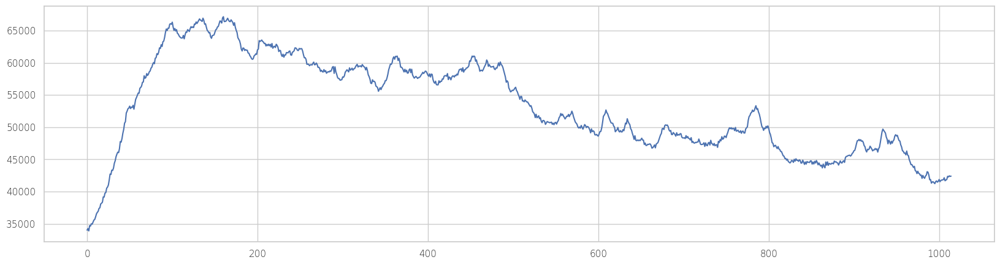

In [153]:
plt.rcParams["figure.figsize"]=20,5
plt.plot(X_test[0],label='1')


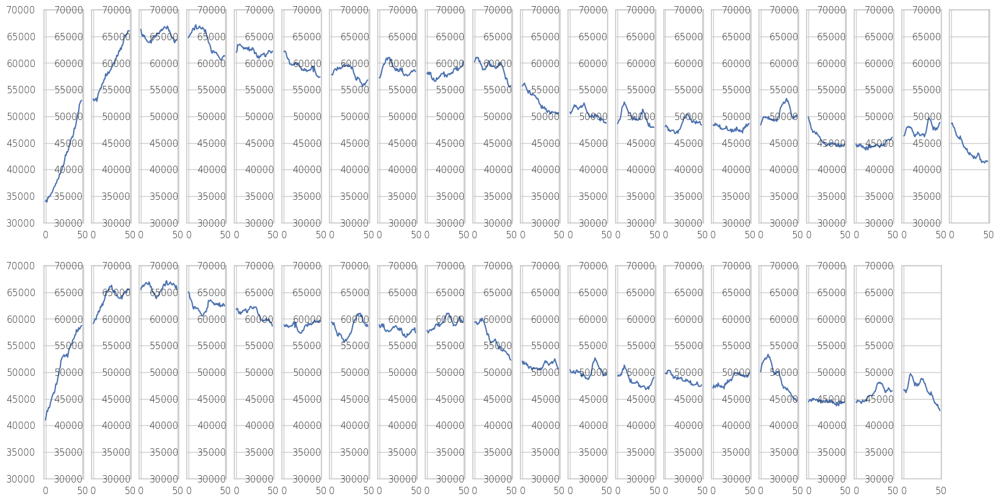

In [152]:
plt.rcParams["figure.figsize"]=20,10

j = 1
k = 21
for i in range(39):
    if i%2 == 0:
        plt.subplot(2,20,j)
        plt.plot(X_test_seg[i][0],label='1')
        j = j+1
        plt.ylim(30000,70000)
    else :
        plt.subplot(2,20,k)
        plt.plot(X_test_seg[i][0],label='1')
        k = k+1 
        plt.ylim(30000,70000)
plt.show()
